<span style="font-size: 20px; font-weight: bold;">Importing all Necessary Libraries</span>

In [1]:
import warnings
warnings.filterwarnings('ignore')
import re
import nltk
import string
import contractions
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objs as go

from bs4 import BeautifulSoup
from nltk.corpus import stopwords
from gensim.models import Word2Vec
from scipy.stats import skew, kurtosis
from nltk.tokenize import word_tokenize
from gensim.utils import simple_preprocess
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from IPython.display import Markdown, display
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics import roc_auc_score, roc_curve, classification_report, confusion_matrix, ConfusionMatrixDisplay

In [2]:
# Download the stopwords from NLTK
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\AB937LH\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\AB937LH\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

<span style="font-size: 18px; font-weight: bold;">Loading the Dataset</span>

In [3]:
data = pd.read_csv(r'C:\projects\toxic-comment-classification\toxic-comment-classification\data\data.csv')

<span style="font-size: 18px; font-weight: bold;">Exploring the Dataset</span>

In [4]:
data.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0001ea8717f6de06,Thank you for understanding. I think very high...,0,0,0,0,0,0
1,000247e83dcc1211,:Dear god this site is horrible.,0,0,0,0,0,0
2,0002f87b16116a7f,"""::: Somebody will invariably try to add Relig...",0,0,0,0,0,0
3,0003e1cccfd5a40a,""" \n\n It says it right there that it IS a typ...",0,0,0,0,0,0
4,00059ace3e3e9a53,""" \n\n == Before adding a new product to the l...",0,0,0,0,0,0


In [5]:
data.sample(n=10)

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
63051,fc6d7f2bb273c537,"""FWIW, removed the external links you're spea...",0,0,0,0,0,0
84994,379599a381486e5d,What different alternative did you propose? I...,0,0,0,0,0,0
187452,94b032e675eb51c7,Zaur Suleymanov \n\nZaur Suleymanov is a well...,0,0,0,0,0,0
94113,501d5cfaeb533387,Requested Move \n\nChange it. Macedonian Trans...,0,0,0,0,0,0
21795,56b428fb77d5414c,""" \n\n == what is consensual voyeurism called ...",0,0,0,0,0,0
206383,f9f7081efc149861,"I'm blocked from touching it, I placed the mai...",0,0,0,0,0,0
199474,d4df2e720a769c18,"""\n\n Lift the protection \n\nIn survey to lif...",0,0,0,0,0,0
113236,83d3c72bb34e2f47,I'd appreciate it if you didn't keep on revert...,0,0,0,0,0,0
189851,a1825f2994d5c38f,These are news articles.'''''',0,0,0,0,0,0
203251,e9a6c74809fddc1d,"Once more, there has been zero legitimate reas...",0,0,0,0,0,0


In [6]:
data.tail()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
223496,ffe987279560d7ff,""":::::And for the second time of asking, when ...",0,0,0,0,0,0
223497,ffea4adeee384e90,You should be ashamed of yourself \n\nThat is ...,0,0,0,0,0,0
223498,ffee36eab5c267c9,"Spitzer \n\nUmm, theres no actual article for ...",0,0,0,0,0,0
223499,fff125370e4aaaf3,And it looks like it was actually you who put ...,0,0,0,0,0,0
223500,fff46fc426af1f9a,"""\nAnd ... I really don't think you understand...",0,0,0,0,0,0


In [7]:
data.shape

(223501, 8)

In [8]:
data.columns

Index(['id', 'comment_text', 'toxic', 'severe_toxic', 'obscene', 'threat',
       'insult', 'identity_hate'],
      dtype='object')

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 223501 entries, 0 to 223500
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   id             223501 non-null  object
 1   comment_text   223501 non-null  object
 2   toxic          223501 non-null  int64 
 3   severe_toxic   223501 non-null  int64 
 4   obscene        223501 non-null  int64 
 5   threat         223501 non-null  int64 
 6   insult         223501 non-null  int64 
 7   identity_hate  223501 non-null  int64 
dtypes: int64(6), object(2)
memory usage: 13.6+ MB


In [10]:
data.describe()

,toxic,severe_toxic,obscene,threat,insult,identity_hate
count,223501.000000,223501.000000,223501.000000,223501.000000,223501.000000,223501.000000
mean,0.095637,0.008774,0.054286,0.003083,0.050555,0.009472
std,0.294094,0.093258,0.226582,0.055437,0.219087,0.096862
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<span style="font-size: 15px; font-weight: bold;">Checking for Missing Values</span>


In [11]:
data.isnull().sum()

id               0
comment_text     0
toxic            0
severe_toxic     0
obscene          0
threat           0
insult           0
identity_hate    0
dtype: int64

<span style="font-size: 15px; font-weight: bold;">Length of the dataset</span>

In [12]:
len(data)

223501

In [13]:
data['comment_text'].fillna("unknown", inplace=True)

In [14]:
data['comment_text']

0         Thank you for understanding. I think very high...
1                          :Dear god this site is horrible.
2         "::: Somebody will invariably try to add Relig...
3         " \n\n It says it right there that it IS a typ...
4         " \n\n == Before adding a new product to the l...
                                ...                        
223496    ":::::And for the second time of asking, when ...
223497    You should be ashamed of yourself \n\nThat is ...
223498    Spitzer \n\nUmm, theres no actual article for ...
223499    And it looks like it was actually you who put ...
223500    "\nAnd ... I really don't think you understand...
Name: comment_text, Length: 223501, dtype: object

In [15]:
comment_len_data = data.comment_text.str.len()

<span style="font-size: 20px; font-weight: bold;">Describing Comment Lengths</span>

In [16]:
comment_len_data.describe()

count    223501.000000
mean        391.016000
std         592.881626
min           1.000000
25%          93.000000
50%         203.000000
75%         431.000000
max        5000.000000
Name: comment_text, dtype: float64

In [17]:
mean_length_data = comment_len_data.mean()
median_length_data = comment_len_data.median()
mode_length_data = comment_len_data.mode()[0]

In [18]:
mean_length_data

391.01599992841193

In [19]:
median_length_data

203.0

In [20]:
mode_length_data

33

In [21]:
skewness_data = skew(comment_len_data)
kurtosis_data = kurtosis(comment_len_data)

In [22]:
skewness_data

4.157440615729811

In [23]:
kurtosis_data

22.06916798770315

In [24]:
quartiles = comment_len_data.quantile([0.25, 0.5, 0.75])
max_length = comment_len_data.max()

In [25]:
quartiles

0.25     93.0
0.50    203.0
0.75    431.0
Name: comment_text, dtype: float64

In [26]:
max_length

5000

<span style="font-size: 20px; font-weight: bold;">Exploratory Data Analysis (EDA)</span>


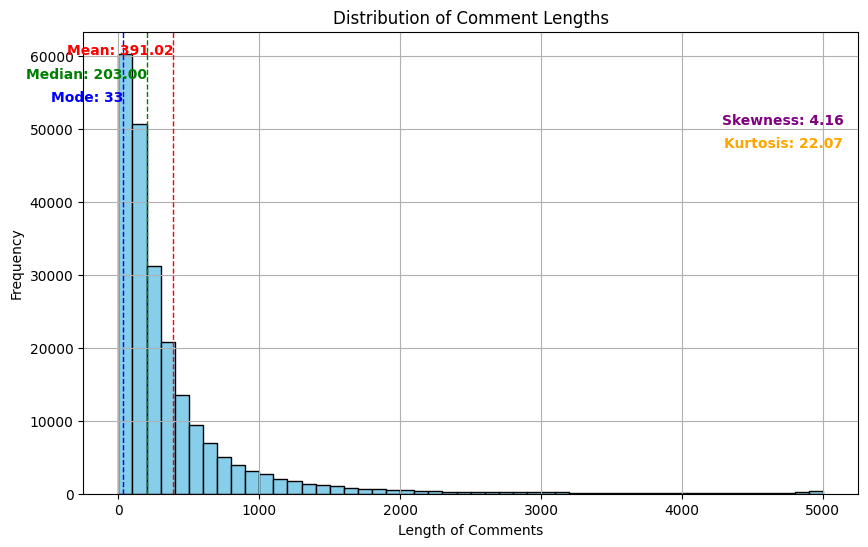

In [27]:
plt.figure(figsize=(10, 6))
plt.hist(comment_len_data, bins=50, color='skyblue', edgecolor='black')

# Annotate mean
plt.axvline(mean_length_data, color='red', linestyle='dashed', linewidth=1)
plt.text(mean_length_data, plt.ylim()[1]*0.95, f'Mean: {mean_length_data:.2f}', color='red', ha='right', fontweight='bold')

# Annotate median
plt.axvline(median_length_data, color='green', linestyle='dashed', linewidth=1)
plt.text(median_length_data, plt.ylim()[1]*0.90, f'Median: {median_length_data:.2f}', color='green', ha='right', fontweight='bold')

# Annotate mode
plt.axvline(mode_length_data, color='blue', linestyle='dashed', linewidth=1)
plt.text(mode_length_data, plt.ylim()[1]*0.85, f'Mode: {mode_length_data}', color='blue', ha='right', fontweight='bold')

# Annotate skewness
plt.text(plt.xlim()[1]*0.98, plt.ylim()[1]*0.80, f'Skewness: {skewness_data:.2f}', color='purple', ha='right', fontweight='bold')

# Annotate kurtosis
plt.text(plt.xlim()[1]*0.98, plt.ylim()[1]*0.75, f'Kurtosis: {kurtosis_data:.2f}', color='orange', ha='right', fontweight='bold')

# Add title and labels
plt.title('Distribution of Comment Lengths')
plt.xlabel('Length of Comments')
plt.ylabel('Frequency')
plt.grid(True)

# Show the plot
plt.show()

### Distribution of Comment Lengths Analysis

- **Average Comment Length**: The dataset's comments have an average length of approximately 391 characters. This suggests that users often engage in detailed discussions or provide elaborate responses within the platform.

- **Median Comment Length**: At 203 characters, the median comment length is significantly lower than the mean. This indicates a right-skewed distribution, where the majority of comments are brief, but a smaller number of lengthy comments increase the average.

- **Mode Comment Length**: The mode length of 33 characters is the most common comment length, indicating a high frequency of very short comments. These could be quick replies or short statements that are common in online interactions.

- **Skewness of Distribution**: The skewness value of 4.157 confirms a right-skewed distribution. This means that while most comments are short, there is a long tail of data representing longer comments.

- **Kurtosis of Distribution**: A kurtosis value of approximately 22.069 suggests a peaked distribution with heavy tails. This indicates a significant presence of outliers, with some comments being much longer than the average.

- **Implications for Preprocessing**: Given that the longest comments reach up to 5000 characters, it's important to consider how to handle these outliers in our machine learning pipeline. We may need to set a maximum input length or use text truncation/summarization techniques to ensure model efficiency without sacrificing important information.

These observations will guide our preprocessing decisions to ensure our machine learning model can handle the wide range of comment lengths effectively.


### Distribution of Toxicity Labels Analysis

In [28]:
# Create a histogram for the 'toxic' column
fig_toxic = px.histogram(data, x='toxic', nbins=2, text_auto=True,
                         labels={'toxic': 'Toxic'}, title='Distribution of Toxic Comments')
fig_toxic.update_traces(marker=dict(color=['green', 'red']),
                        marker_line_color='black', marker_line_width=1.5)
fig_toxic.update_layout(xaxis=dict(tickvals=[0, 1], ticktext=['Not Toxic', 'Toxic']),
                        yaxis_title='Count', bargap=0.2, plot_bgcolor='white')
fig_toxic.show()

In [29]:
# Create a histogram for the 'severe_toxic' column
fig_severe_toxic = px.histogram(data, x='severe_toxic', nbins=2, text_auto=True,
                                labels={'severe_toxic': 'Severe Toxic'}, title='Distribution of Severe Toxic Comments')
fig_severe_toxic.update_traces(marker=dict(color=['green', 'red']),
                               marker_line_color='black', marker_line_width=1.5)
fig_severe_toxic.update_layout(xaxis=dict(tickvals=[0, 1], ticktext=['Not Severe Toxic', 'Severe Toxic']),
                               yaxis_title='Count', bargap=0.2, plot_bgcolor='white')
fig_severe_toxic.show()

In [30]:
# Create a histogram for the 'obscene' column
fig_obscene = px.histogram(data, x='obscene', nbins=2, text_auto=True,
                           labels={'obscene': 'Obscene'}, title='Distribution of Obscene Comments')
fig_obscene.update_traces(marker=dict(color=['green', 'red']),
                          marker_line_color='black', marker_line_width=1.5)
fig_obscene.update_layout(xaxis=dict(tickvals=[0, 1], ticktext=['Not Obscene', 'Obscene']),
                          yaxis_title='Count', bargap=0.2, plot_bgcolor='white')
fig_obscene.show()

In [31]:
# Create a histogram for the 'threat' column
fig_threat = px.histogram(data, x='threat', nbins=2, text_auto=True,
                          labels={'threat': 'Threat'}, title='Distribution of Threat Comments')
fig_threat.update_traces(marker=dict(color=['green', 'red']),
                         marker_line_color='black', marker_line_width=1.5)
fig_threat.update_layout(xaxis=dict(tickvals=[0, 1], ticktext=['Not Threat', 'Threat']),
                         yaxis_title='Count', bargap=0.2, plot_bgcolor='white')
fig_threat.show()

In [32]:
# Create a histogram for the 'insult' column
fig_insult = px.histogram(data, x='insult', nbins=2, text_auto=True,
                          labels={'insult': 'Insult'}, title='Distribution of Insult Comments')
fig_insult.update_traces(marker=dict(color=['green', 'red']),
                         marker_line_color='black', marker_line_width=1.5)
fig_insult.update_layout(xaxis=dict(tickvals=[0, 1], ticktext=['Not Insult', 'Insult']),
                         yaxis_title='Count', bargap=0.2, plot_bgcolor='white')
fig_insult.show()

In [33]:
# Create a histogram for the 'identity_hate' column
fig_identity_hate = px.histogram(data, x='identity_hate', nbins=2, text_auto=True,
                                 labels={'identity_hate': 'Identity Hate'}, title='Distribution of Identity Hate Comments')
fig_identity_hate.update_traces(marker=dict(color=['green', 'red']),
                                marker_line_color='black', marker_line_width=1.5)
fig_identity_hate.update_layout(xaxis=dict(tickvals=[0, 1], ticktext=['Not Identity Hate', 'Identity Hate']),
                                yaxis_title='Count', bargap=0.2, plot_bgcolor='white')
fig_identity_hate.show()

* As we can see the data is an imbalanced data when we see the distribution between different categories, we can see that there is huge data imbalance which needs to be rectified.

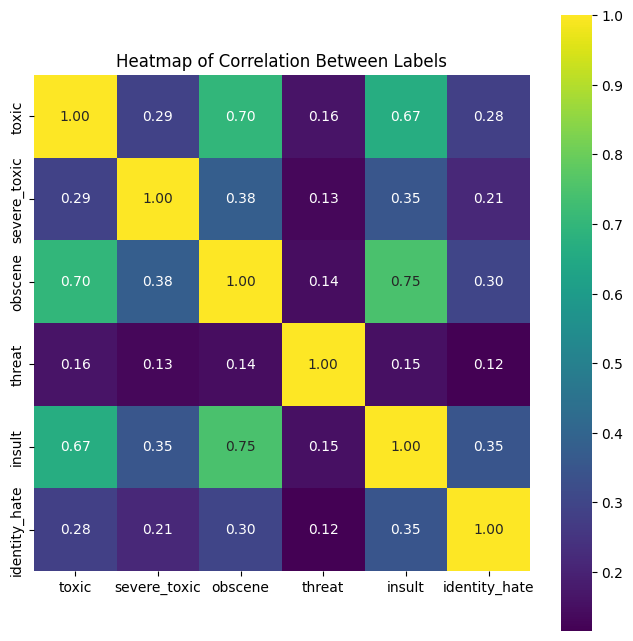

In [34]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'data' is your DataFrame and it contains the y variables
y_variables_data = data[['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']]

# Calculate the correlation matrix
corr_matrix = y_variables_data.corr()

# Create a heatmap
plt.figure(figsize=(8, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='viridis', cbar=True, square=True)

# Add title
plt.title('Heatmap of Correlation Between Labels')

# Show the plot
plt.show()

In [35]:
class TextPreprocessor:
    def __init__(self):
        self.stop_words = set(stopwords.words('english'))

    def remove_html_tags(self, text):
        soup = BeautifulSoup(text, "html.parser")
        return soup.get_text(separator=" ")

    def remove_punctuation(self, text):
        return text.translate(str.maketrans('', '', string.punctuation))

    def to_lower_case(self, text):
        return text.lower()

    def remove_numbers(self, text):
        return re.sub(r'\d+', '', text)

    def expand_contractions(self, text):
        return contractions.fix(text)

    def remove_stopwords(self, text):
        tokens = word_tokenize(text)
        filtered_text = [word for word in tokens if word not in self.stop_words]
        return ' '.join(filtered_text)

    def clean_text(self, text):
        text = text.lower()
        text = re.sub(r"[^a-zA-Z0-9\s]", "", text)  # Remove non-alphanumeric characters (consider basic punctuation)
        return text

    def remove_extra_spaces(self, text):
        return re.sub(r'\s+', ' ', text).strip()

    def preprocess(self, text):
        text = self.remove_html_tags(text)
        text = self.remove_punctuation(text)
        text = self.to_lower_case(text)
        text = self.remove_numbers(text)
        text = self.expand_contractions(text)
        text = self.remove_stopwords(text)
        text = self.clean_text(text)
        text = self.remove_extra_spaces(text)  # Remove extra spaces
        return text

In [36]:
# Create an instance of the TextPreprocessor class
preprocessor = TextPreprocessor()

In [37]:
# Apply the preprocessing to the 'comment_text' column
data['TextPreprocessor_comment_text'] = data['comment_text'].apply(preprocessor.preprocess)

In [38]:
data['TextPreprocessor_comment_text']

0         thank understanding think highly would revert ...
1                                    dear god site horrible
2         somebody invariably try add religion really me...
3         says right type type institution needed case t...
4         adding new product list make sure relevant add...
                                ...                        
223496    second time asking view completely contradicts...
223497                 ashamed horrible thing put talk page
223498    spitzer umm actual article prostitution ring c...
223499    looks like actually put speedy first version d...
223500    really think understand came idea bad right aw...
Name: TextPreprocessor_comment_text, Length: 223501, dtype: object

In [39]:
import pandas as pd
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
import nltk

# Download the required NLTK data
nltk.download('punkt')
nltk.download('wordnet')

# Initialize the WordNetLemmatizer
lemmatizer = WordNetLemmatizer()

# Function to apply lemmatization to a text
def lemmatize_text(text):
    tokens = word_tokenize(text)
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]
    lemmatized_text = ' '.join(lemmatized_tokens)
    return lemmatized_text

# Assuming 'data' is your DataFrame and 'comment_text' is the column you want to process
# Apply the lemmatization function to the 'comment_text' column
data['lemmatized_comment_text'] = data['TextPreprocessor_comment_text'].apply(lemmatize_text)

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\AB937LH\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\AB937LH\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [40]:
data['comment_text']

0         Thank you for understanding. I think very high...
1                          :Dear god this site is horrible.
2         "::: Somebody will invariably try to add Relig...
3         " \n\n It says it right there that it IS a typ...
4         " \n\n == Before adding a new product to the l...
                                ...                        
223496    ":::::And for the second time of asking, when ...
223497    You should be ashamed of yourself \n\nThat is ...
223498    Spitzer \n\nUmm, theres no actual article for ...
223499    And it looks like it was actually you who put ...
223500    "\nAnd ... I really don't think you understand...
Name: comment_text, Length: 223501, dtype: object

In [41]:
data['TextPreprocessor_comment_text']

0         thank understanding think highly would revert ...
1                                    dear god site horrible
2         somebody invariably try add religion really me...
3         says right type type institution needed case t...
4         adding new product list make sure relevant add...
                                ...                        
223496    second time asking view completely contradicts...
223497                 ashamed horrible thing put talk page
223498    spitzer umm actual article prostitution ring c...
223499    looks like actually put speedy first version d...
223500    really think understand came idea bad right aw...
Name: TextPreprocessor_comment_text, Length: 223501, dtype: object

In [42]:
data['lemmatized_comment_text']

0         thank understanding think highly would revert ...
1                                    dear god site horrible
2         somebody invariably try add religion really me...
3         say right type type institution needed case th...
4         adding new product list make sure relevant add...
                                ...                        
223496    second time asking view completely contradicts...
223497                 ashamed horrible thing put talk page
223498    spitzer umm actual article prostitution ring c...
223499    look like actually put speedy first version de...
223500    really think understand came idea bad right aw...
Name: lemmatized_comment_text, Length: 223501, dtype: object

In [43]:
data.columns

Index(['id', 'comment_text', 'toxic', 'severe_toxic', 'obscene', 'threat',
       'insult', 'identity_hate', 'TextPreprocessor_comment_text',
       'lemmatized_comment_text'],
      dtype='object')

In [44]:
data.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,TextPreprocessor_comment_text,lemmatized_comment_text
0,0001ea8717f6de06,Thank you for understanding. I think very high...,0,0,0,0,0,0,thank understanding think highly would revert ...,thank understanding think highly would revert ...
1,000247e83dcc1211,:Dear god this site is horrible.,0,0,0,0,0,0,dear god site horrible,dear god site horrible
2,0002f87b16116a7f,"""::: Somebody will invariably try to add Relig...",0,0,0,0,0,0,somebody invariably try add religion really me...,somebody invariably try add religion really me...
3,0003e1cccfd5a40a,""" \n\n It says it right there that it IS a typ...",0,0,0,0,0,0,says right type type institution needed case t...,say right type type institution needed case th...
4,00059ace3e3e9a53,""" \n\n == Before adding a new product to the l...",0,0,0,0,0,0,adding new product list make sure relevant add...,adding new product list make sure relevant add...


In [45]:
data['comment_text'][3]

'" \n\n It says it right there that it IS a type. The ""Type"" of institution is needed in this case because there are three levels of SUNY schools: \n -University Centers and Doctoral Granting Institutions \n -State Colleges \n -Community Colleges. \n\n It is needed in this case to clarify that UB is a SUNY Center. It says it even in Binghamton University, University at Albany, State University of New York, and Stony Brook University. Stop trying to say it\'s not because I am totally right in this case."'

In [46]:
data['TextPreprocessor_comment_text'][3]

'says right type type institution needed case three levels suny schools university centers doctoral granting institutions state colleges community colleges needed case clarify ub suny center says even binghamton university university albany state university new york stony brook university stop trying say totally right case'

In [47]:
data['lemmatized_comment_text'][3]

'say right type type institution needed case three level suny school university center doctoral granting institution state college community college needed case clarify ub suny center say even binghamton university university albany state university new york stony brook university stop trying say totally right case'

In [48]:
data.tail()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,TextPreprocessor_comment_text,lemmatized_comment_text
223496,ffe987279560d7ff,""":::::And for the second time of asking, when ...",0,0,0,0,0,0,second time asking view completely contradicts...,second time asking view completely contradicts...
223497,ffea4adeee384e90,You should be ashamed of yourself \n\nThat is ...,0,0,0,0,0,0,ashamed horrible thing put talk page,ashamed horrible thing put talk page
223498,ffee36eab5c267c9,"Spitzer \n\nUmm, theres no actual article for ...",0,0,0,0,0,0,spitzer umm actual article prostitution ring c...,spitzer umm actual article prostitution ring c...
223499,fff125370e4aaaf3,And it looks like it was actually you who put ...,0,0,0,0,0,0,looks like actually put speedy first version d...,look like actually put speedy first version de...
223500,fff46fc426af1f9a,"""\nAnd ... I really don't think you understand...",0,0,0,0,0,0,really think understand came idea bad right aw...,really think understand came idea bad right aw...


In [49]:
data['comment_text'][0]

'Thank you for understanding. I think very highly of you and would not revert without discussion.'

In [50]:
data['comment_text'][1]

':Dear god this site is horrible.'

In [51]:
# Assuming 'data' is your DataFrame and 'comment_text' is the column of interest.

# Check for null values and count them
null_count = data['lemmatized_comment_text'].isnull().sum()
print(f"Number of null values: {null_count}")

# Check for blank strings (after stripping any leading/trailing whitespace) and count them
blank_count = data['lemmatized_comment_text'].apply(lambda x: x.strip() == '').sum()
print(f"Number of blank strings: {blank_count}")

# Total count of either null or blank strings
total_count = null_count + blank_count
print(f"Total number of null or blank strings: {total_count}")

Number of null values: 0
Number of blank strings: 488
Total number of null or blank strings: 488


In [52]:
data.shape

(223501, 10)

In [53]:
# Assuming 'data' is your DataFrame and 'comment_text' is the column of interest.

# Drop rows with null values in 'comment_text' column
data = data.dropna(subset=['lemmatized_comment_text'])

# Drop rows with blank strings in 'comment_text' column (after stripping any leading/trailing whitespace)
data = data[data['lemmatized_comment_text'].str.strip() != '']

# Now 'data' contains only rows where 'comment_text' is neither null nor a blank string

In [54]:
data.shape

(223013, 10)

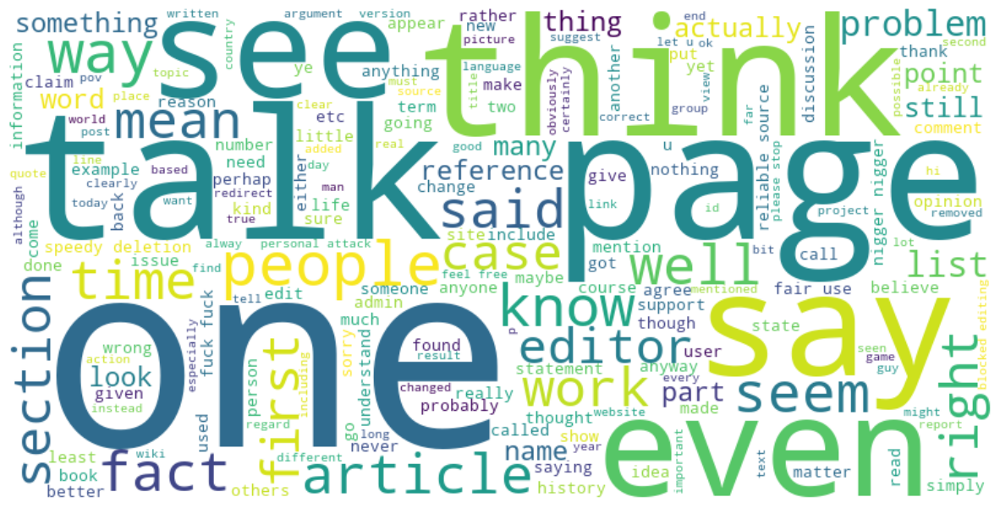

In [55]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Assuming 'data' is your DataFrame and 'comment_text' is the column of interest
# Concatenate all the comments into a single string
text = ' '.join(comment for comment in data['lemmatized_comment_text'])

# Create a WordCloud object
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

# Display the generated word cloud image
plt.figure(figsize=(15, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Turn off the axis
plt.show()

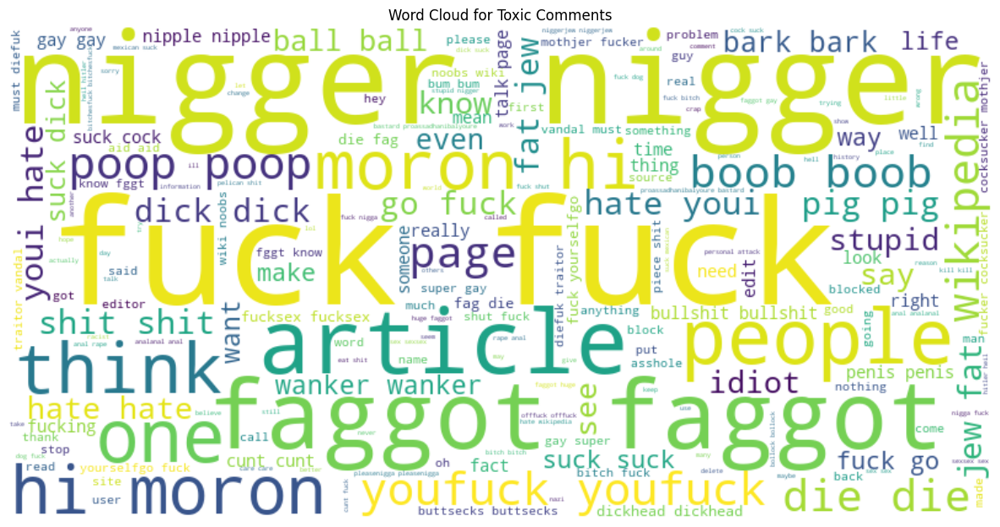

In [56]:
# Assuming 'data' is your DataFrame, 'comment_text' is the column with text, and 'toxic' is the binary column indicating toxicity

# Filter the comments that are labeled as toxic (where 'toxic' column value is 1)
toxic_comments = data[data['toxic'] == 1]['lemmatized_comment_text']

# Concatenate all the toxic comments into a single string
toxic_text = ' '.join(comment for comment in toxic_comments)

# Create a WordCloud object for toxic comments
toxic_wordcloud = WordCloud(width=800, height=400, background_color='white').generate(toxic_text)

# Display the generated word cloud image for toxic comments
plt.figure(figsize=(15, 8))
plt.imshow(toxic_wordcloud, interpolation='bilinear')
plt.axis('off')  # Turn off the axis
plt.title('Word Cloud for Toxic Comments')
plt.show()

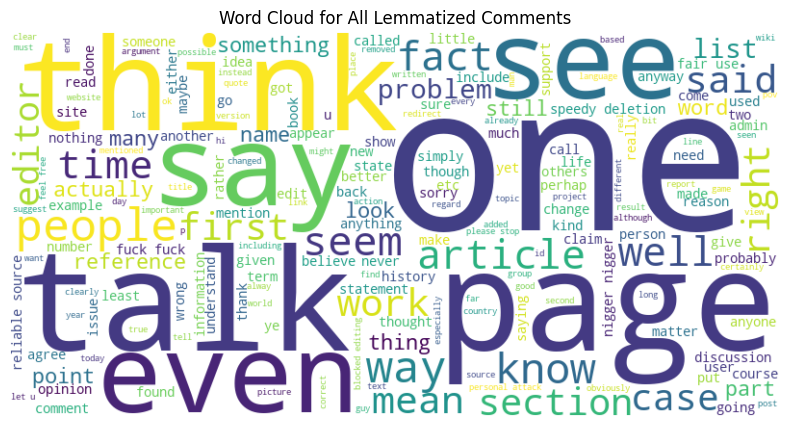

Top 10 words for All Lemmatized Comments:
article: 100433
page: 74434
wikipedia: 46596
would: 45219
one: 41146
please: 39269
like: 38918
talk: 37605
source: 29804
see: 29673


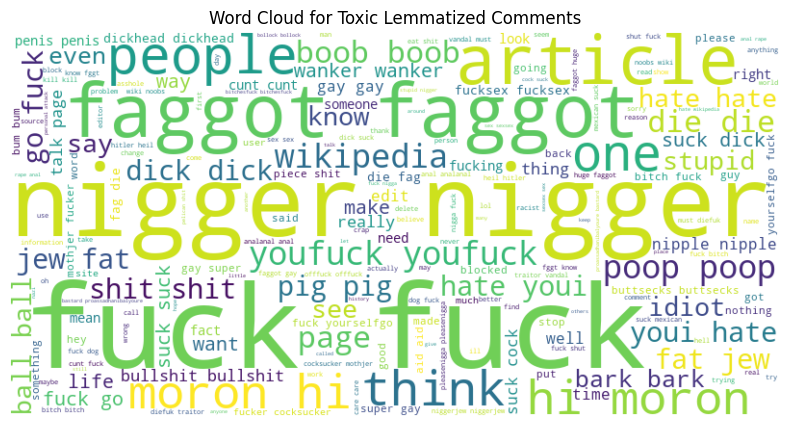

Top 10 words for Toxic Lemmatized Comments:
fuck: 14262
nigger: 6727
suck: 5946
fucking: 4959
like: 4894
shit: 4856
faggot: 4016
wikipedia: 3827
hate: 3804
as: 3671


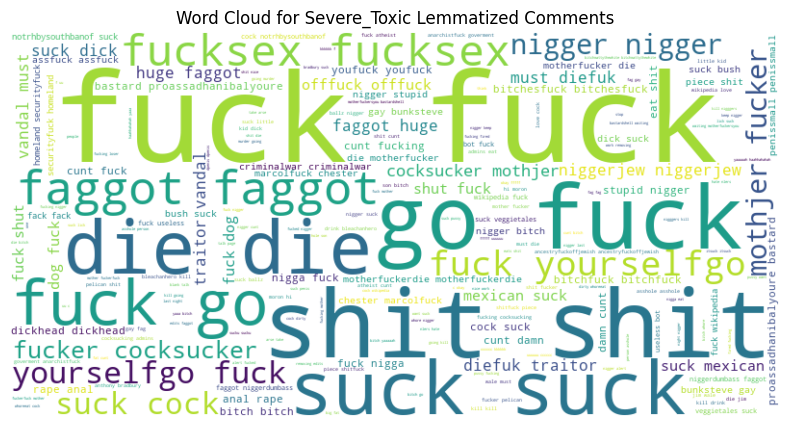

Top 10 words for Severe_Toxic Lemmatized Comments:
fuck: 7452
suck: 3825
shit: 2433
as: 2333
nigger: 2177
fucking: 2072
faggot: 1860
bitch: 1832
die: 1758
cunt: 1406


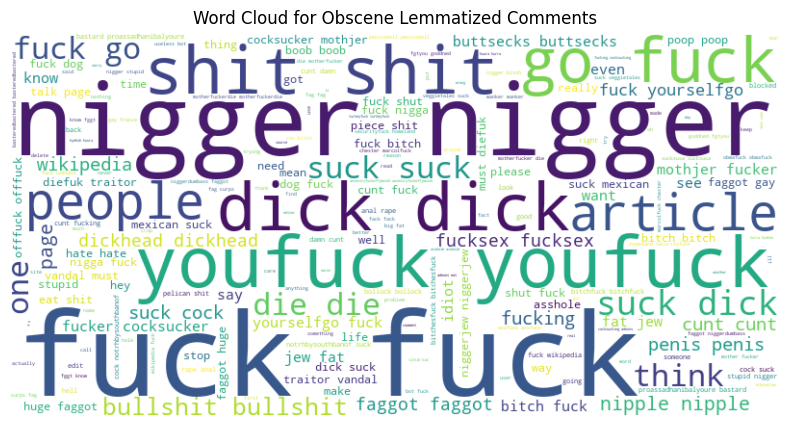

Top 10 words for Obscene Lemmatized Comments:
fuck: 14148
nigger: 5400
suck: 5052
fucking: 4834
shit: 4424
as: 3545
bitch: 3190
dick: 3176
cunt: 2618
like: 2537


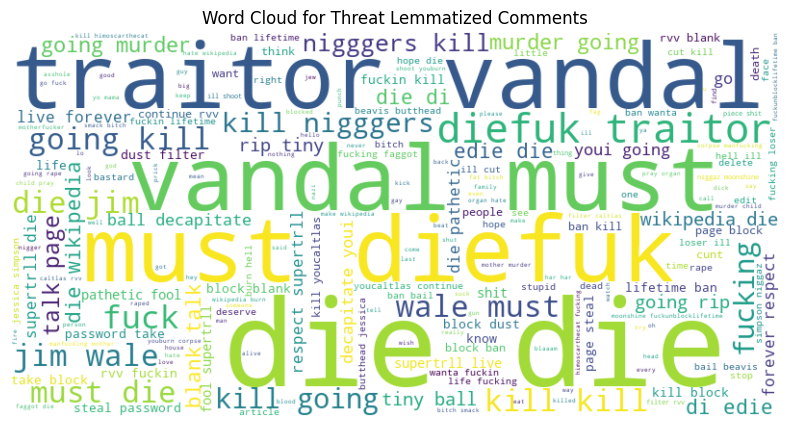

Top 10 words for Threat Lemmatized Comments:
die: 1264
kill: 816
as: 788
going: 496
must: 490
vandal: 316
traitor: 315
diefuk: 310
fucking: 257
fuck: 196


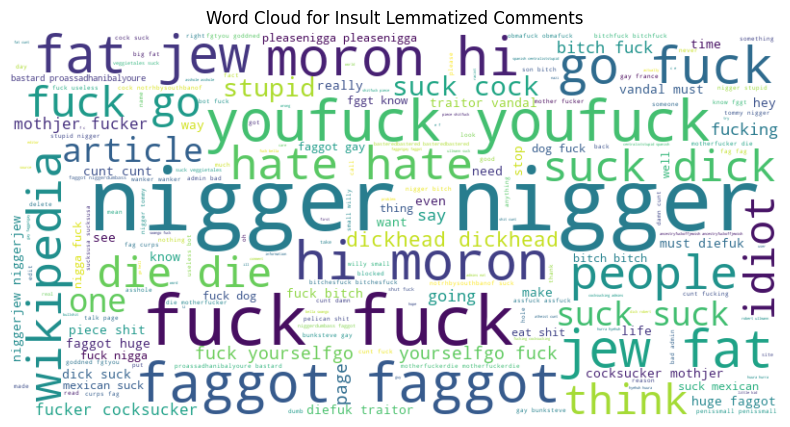

Top 10 words for Insult Lemmatized Comments:
fuck: 10210
nigger: 6172
suck: 4621
fucking: 4111
faggot: 3127
bitch: 3106
as: 2824
shit: 2748
go: 2604
like: 2494


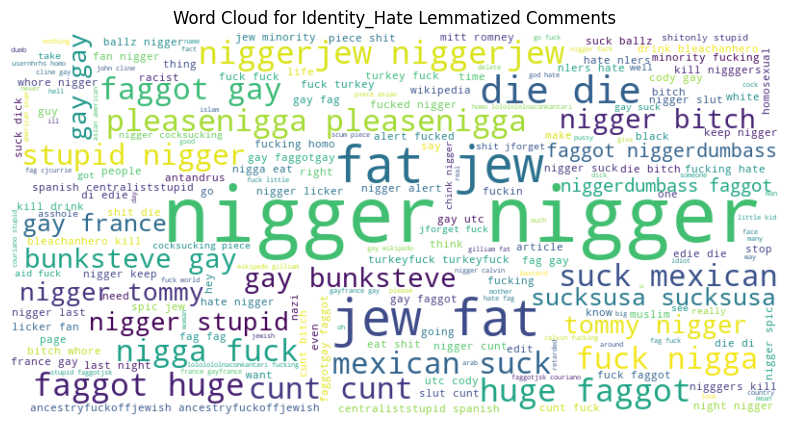

Top 10 words for Identity_Hate Lemmatized Comments:
nigger: 6377
gay: 2077
fuck: 1605
jew: 1537
fat: 1399
faggot: 1340
fucking: 1008
die: 942
bitch: 792
as: 750


In [57]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter

# Function to plot word cloud for a given series of text
def plot_word_cloud(series, title):
    all_text = ' '.join(series)
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)
    
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

# Function to print top 10 words for a given series of text
def print_top_words(series, title):
    all_text = ' '.join(series)
    word_counts = Counter(all_text.split())
    most_common = word_counts.most_common(10)
    
    print(f"Top 10 words for {title}:")
    for word, count in most_common:
        print(f"{word}: {count}")

# Plot word cloud for general lemmatized_comment_text
plot_word_cloud(data['lemmatized_comment_text'], 'Word Cloud for All Lemmatized Comments')

# Print top 10 words for general lemmatized_comment_text
print_top_words(data['lemmatized_comment_text'], 'All Lemmatized Comments')

# Plot word cloud and print top 10 words for each category
columns_to_analyze = ['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']
for column in columns_to_analyze:
    filtered_comments = data[data[column] == 1]['lemmatized_comment_text']
    plot_word_cloud(filtered_comments, f'Word Cloud for {column.title()} Lemmatized Comments')
    print_top_words(filtered_comments, f'{column.title()} Lemmatized Comments')

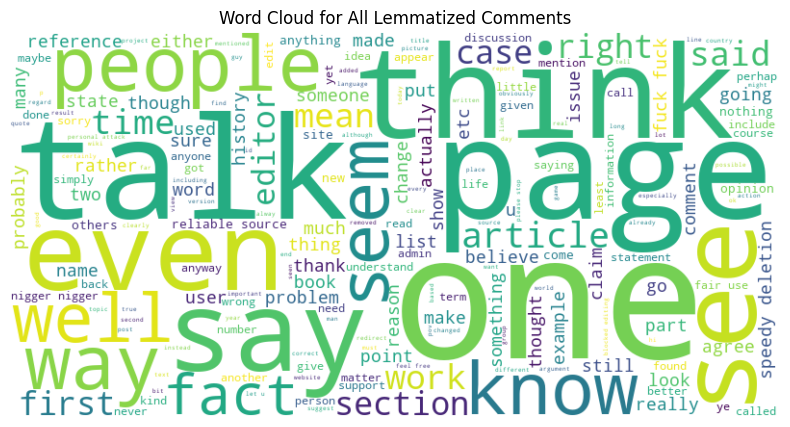

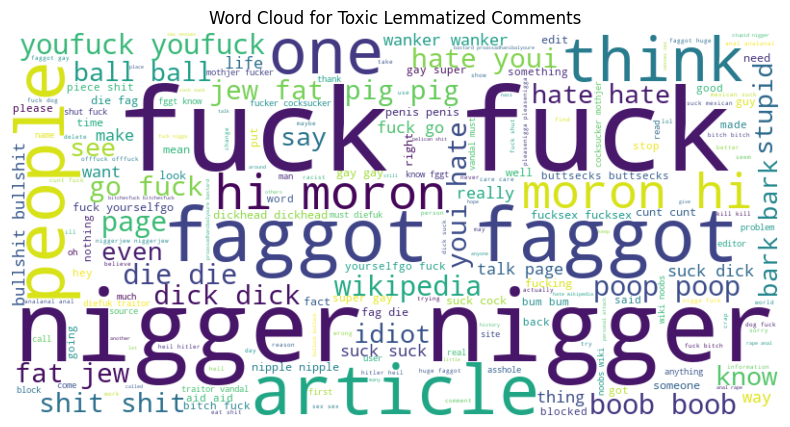

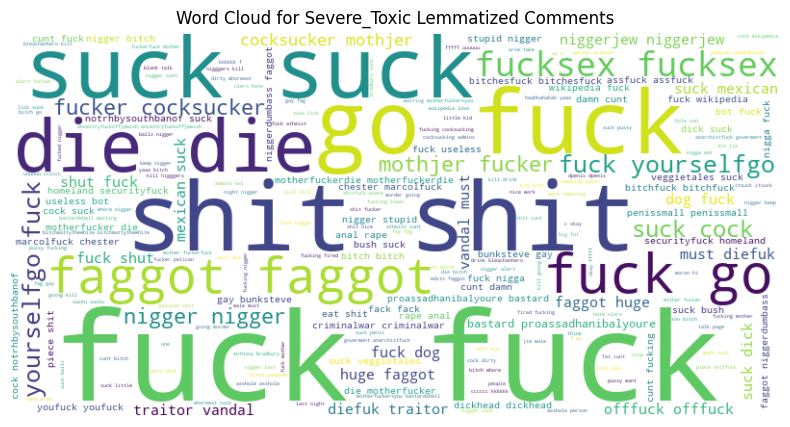

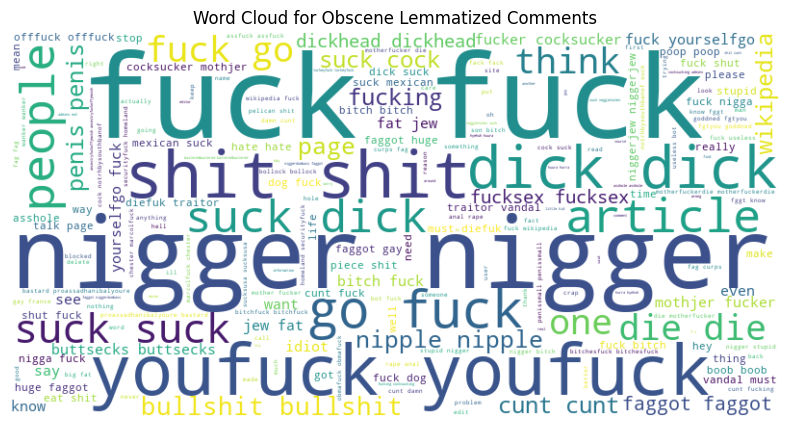

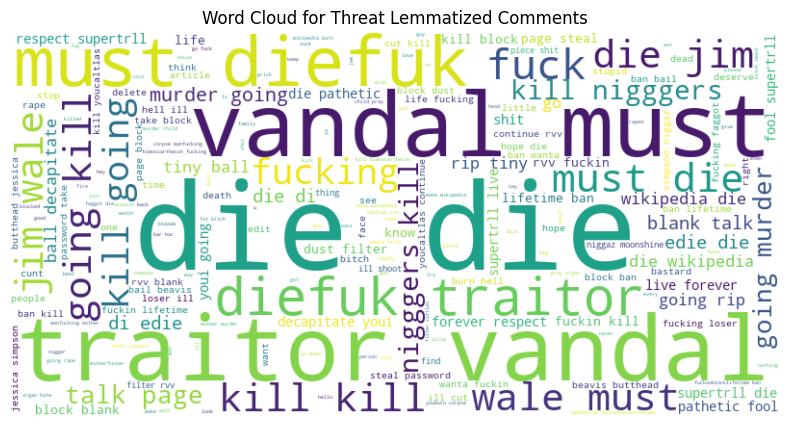

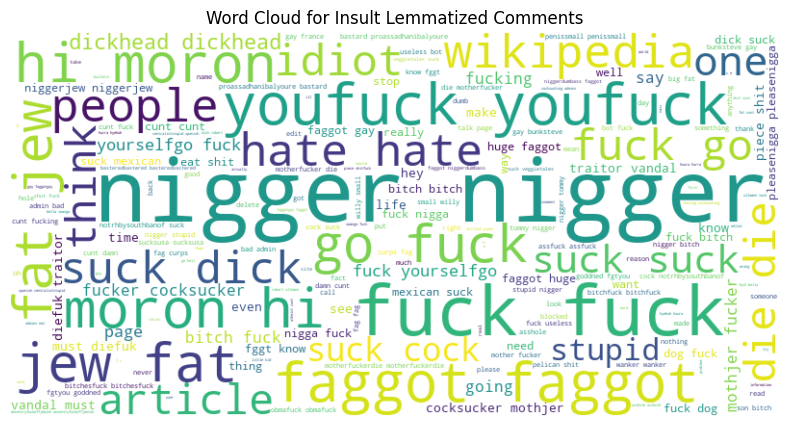

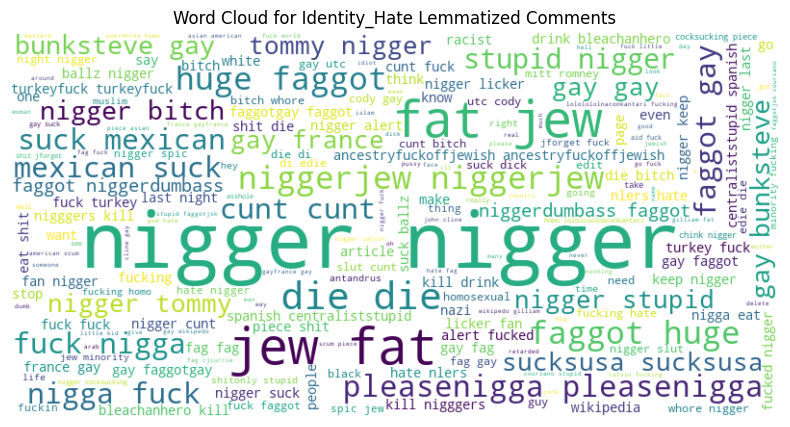

In [58]:
import plotly.express as px
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter

# Function to plot word cloud for a given series of text
def plot_word_cloud(series, title):
    all_text = ' '.join(series)
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)
    
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

# Function to plot top 10 words using Plotly for a given series of text
def plot_top_words(series, title):
    all_text = ' '.join(series)
    word_counts = Counter(all_text.split())
    most_common = word_counts.most_common(10)
    
    words = [word for word, count in most_common]
    counts = [count for word, count in most_common]
    
    fig = px.bar(x=words, y=counts, title=f"Top 10 Words for {title}", labels={'x':'Word', 'y':'Count'})
    fig.show()

# Example usage with a hypothetical 'data' variable containing the text series
# Plot word cloud for general lemmatized_comment_text
plot_word_cloud(data['lemmatized_comment_text'], 'Word Cloud for All Lemmatized Comments')

# Plot top 10 words for general lemmatized_comment_text
plot_top_words(data['lemmatized_comment_text'], 'All Lemmatized Comments')

# Plot word cloud and plot top 10 words using Plotly for each category
columns_to_analyze = ['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']
for column in columns_to_analyze:
    filtered_comments = data[data[column] == 1]['lemmatized_comment_text']
    plot_word_cloud(filtered_comments, f'Word Cloud for {column.title()} Lemmatized Comments')
    plot_top_words(filtered_comments, f'{column.title()} Lemmatized Comments')

In [59]:
# Initialize the TfidfVectorizer with the strip_accents parameter set to 'unicode'
tfidf_vectorizer = TfidfVectorizer(strip_accents='unicode', max_features=10000)

In [60]:
# Fit the vectorizer to the text data and transform it into a TF-IDF-weighted document-term matrix
tfidf_matrix = tfidf_vectorizer.fit_transform(data['lemmatized_comment_text'].astype('unicode').values)

In [61]:
tfidf_matrix

<223013x10000 sparse matrix of type '<class 'numpy.float64'>'
	with 5084889 stored elements in Compressed Sparse Row format>

In [62]:
tfidf_df = pd.DataFrame.sparse.from_spmatrix(tfidf_matrix, columns=tfidf_vectorizer.get_feature_names_out())

In [63]:
tfidf_df

,aa,aaron,ab,abandon,abandoned,abbey,abbreviation,abc,abdul,abide,...,zeuphoris,zeus,zionism,zionist,zoe,zombie,zone,zoo,zu,zuck
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
223008,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
223009,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
223010,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
223011,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [64]:
tfidf_df.head()

,aa,aaron,ab,abandon,abandoned,abbey,abbreviation,abc,abdul,abide,...,zeuphoris,zeus,zionism,zionist,zoe,zombie,zone,zoo,zu,zuck
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [65]:
tfidf_df.columns

Index(['aa', 'aaron', 'ab', 'abandon', 'abandoned', 'abbey', 'abbreviation',
       'abc', 'abdul', 'abide',
       ...
       'zeuphoris', 'zeus', 'zionism', 'zionist', 'zoe', 'zombie', 'zone',
       'zoo', 'zu', 'zuck'],
      dtype='object', length=10000)

In [66]:
# Convert the column names to a list and print it
column_names = tfidf_df.columns.tolist()

In [67]:
print(column_names)

['aa', 'aaron', 'ab', 'abandon', 'abandoned', 'abbey', 'abbreviation', 'abc', 'abdul', 'abide', 'ability', 'able', 'abolished', 'aboriginal', 'abortion', 'abraham', 'abroad', 'absence', 'absent', 'absolute', 'absolutely', 'absorbed', 'abstract', 'absurd', 'absurdity', 'abu', 'abuse', 'abused', 'abuser', 'abusing', 'abusive', 'ac', 'academia', 'academic', 'academy', 'acceleration', 'accent', 'accept', 'acceptable', 'acceptance', 'accepted', 'accepting', 'accepts', 'access', 'accessed', 'accessible', 'accident', 'accidental', 'accidentally', 'accommodate', 'accompanied', 'accompanying', 'accomplish', 'accomplished', 'accomplishment', 'accord', 'accordance', 'according', 'accordingly', 'account', 'accountable', 'accounting', 'accreditation', 'accredited', 'accuracy', 'accurate', 'accurately', 'accusation', 'accuse', 'accused', 'accuses', 'accusing', 'ace', 'achieve', 'achieved', 'achievement', 'achieving', 'acid', 'acknowledge', 'acknowledged', 'acknowledgement', 'acknowledges', 'acknowle

In [68]:
# Function to print in bold
def print_bold(text):
    display(Markdown(f"**{text}**"))

In [69]:
# 2. List all the y variables in one list
y_variables = ['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']

In [70]:
# 3. List TF-IDF and BoW vectorizers
vectorizers = {
    'bow': CountVectorizer(strip_accents='unicode', max_features=10000),
    'tfidf': TfidfVectorizer(strip_accents='unicode', max_features=10000),
}

In [71]:
# 4. List Logistic Regression and Naive Bayes algorithms
algorithms = {
    'logistic_regression': LogisticRegression(max_iter=1000),
    'naive_bayes': MultinomialNB(),
}

In [72]:
# Assuming data is your dataset with 'comment_text' and y variables
X = data['lemmatized_comment_text']
y = data[y_variables]

In [73]:
# Split the dataset into train, validation, and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.1875, random_state=42) # 0.1875 * 0.8 = 0.15

In [74]:
# Function to evaluate models for each label with TF-IDF and BoW vectorizers
def evaluate_models_with_tfidf_bow(X_train, X_val, y_train, y_val, vectorizers, algorithms, n_splits=5):
    skf = StratifiedKFold(n_splits=n_splits)
    
    for vec_name, vectorizer in vectorizers.items():
        X_train_vec = vectorizer.fit_transform(X_train)
        X_val_vec = vectorizer.transform(X_val)
        
        for alg_name, algorithm in algorithms.items():
            fold_auc_scores = []
            
            for train_index, val_index in skf.split(X_train_vec, y_train):
                X_fold_train, X_fold_val = X_train_vec[train_index], X_train_vec[val_index]
                y_fold_train, y_fold_val = y_train.iloc[train_index], y_train.iloc[val_index]
                
                algorithm.fit(X_fold_train, y_fold_train)
                y_fold_pred_prob = algorithm.predict_proba(X_fold_val)[:, 1]
                fold_auc_score = roc_auc_score(y_fold_val, y_fold_pred_prob)
                fold_auc_scores.append(fold_auc_score)
            
            # Average AUC score across folds
            avg_fold_auc = np.mean(fold_auc_scores)
            
            # Validation AUC score
            algorithm.fit(X_train_vec, y_train)
            y_val_pred_prob = algorithm.predict_proba(X_val_vec)[:, 1]
            val_auc_score = roc_auc_score(y_val, y_val_pred_prob)
            
            # Print AUC ROC score in bold
            print_bold(f"ROC AUC score for {alg_name} with {vec_name}: {val_auc_score:.2f}")
            
            # Print classification report
            y_val_pred = algorithm.predict(X_val_vec)
            print(f"Classification report for {alg_name} with {vec_name}:")
            print(classification_report(y_val, y_val_pred))
            
            # Print confusion matrix
            print(f"Confusion matrix for {alg_name} with {vec_name}:")
            cm = confusion_matrix(y_val, y_val_pred)
            print(cm)
            
            # Plot confusion matrix diagram
            ConfusionMatrixDisplay.from_predictions(y_val, y_val_pred)
            plt.title(f'Confusion Matrix for {alg_name} with {vec_name}')
            plt.show()
            
            # Plot ROC curve
            fpr, tpr, _ = roc_curve(y_val, y_val_pred_prob)
            plt.plot(fpr, tpr, label=f'{alg_name} with {vec_name} (AUC = {val_auc_score:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.title(f'ROC Curve for {alg_name} with {vec_name}')
            plt.legend(loc='lower right')
            plt.show()

**Evaluating label: toxic**

**ROC AUC score for logistic_regression with bow: 0.94**

Classification report for logistic_regression with bow:
              precision    recall  f1-score   support

           0       0.96      0.98      0.97     30160
           1       0.79      0.60      0.68      3292

    accuracy                           0.94     33452
   macro avg       0.87      0.79      0.82     33452
weighted avg       0.94      0.94      0.94     33452

Confusion matrix for logistic_regression with bow:
[[29633   527]
 [ 1331  1961]]


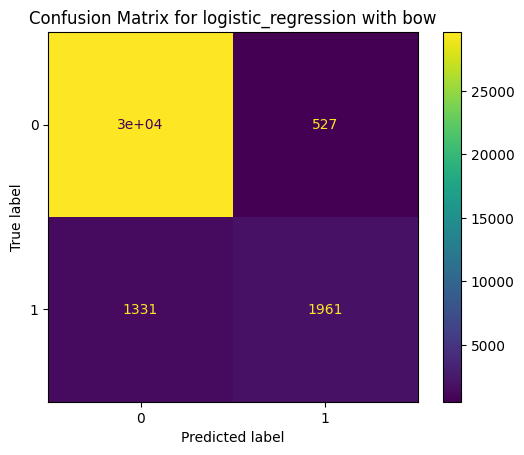

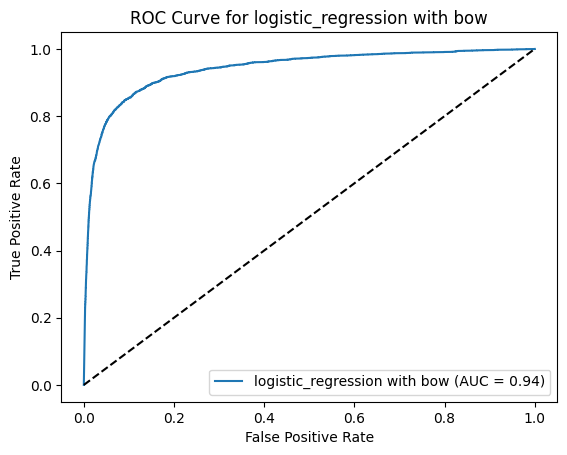

**ROC AUC score for naive_bayes with bow: 0.92**

Classification report for naive_bayes with bow:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97     30160
           1       0.72      0.68      0.70      3292

    accuracy                           0.94     33452
   macro avg       0.84      0.82      0.83     33452
weighted avg       0.94      0.94      0.94     33452

Confusion matrix for naive_bayes with bow:
[[29293   867]
 [ 1059  2233]]


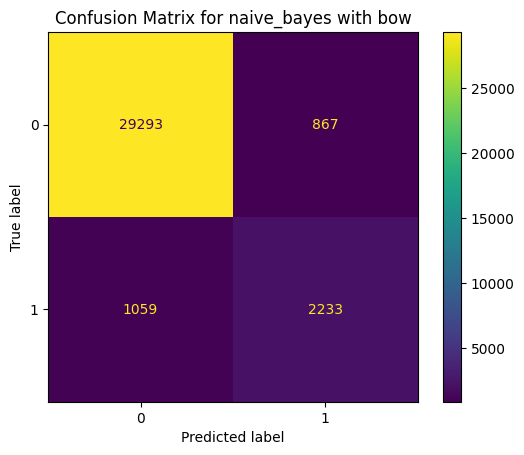

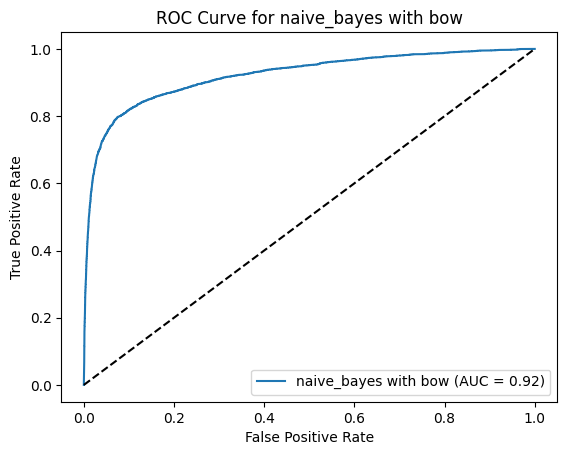

**ROC AUC score for logistic_regression with tfidf: 0.96**

Classification report for logistic_regression with tfidf:
              precision    recall  f1-score   support

           0       0.96      0.99      0.97     30160
           1       0.86      0.57      0.69      3292

    accuracy                           0.95     33452
   macro avg       0.91      0.78      0.83     33452
weighted avg       0.95      0.95      0.94     33452

Confusion matrix for logistic_regression with tfidf:
[[29864   296]
 [ 1404  1888]]


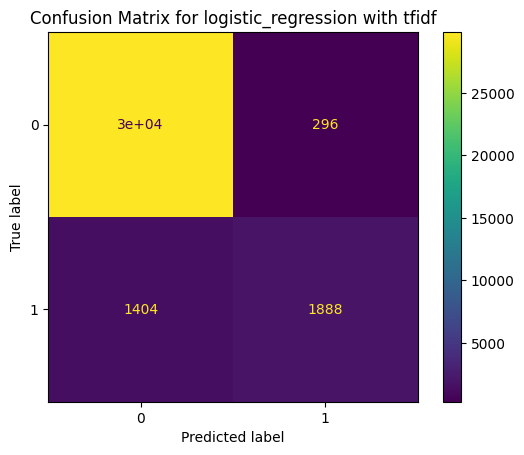

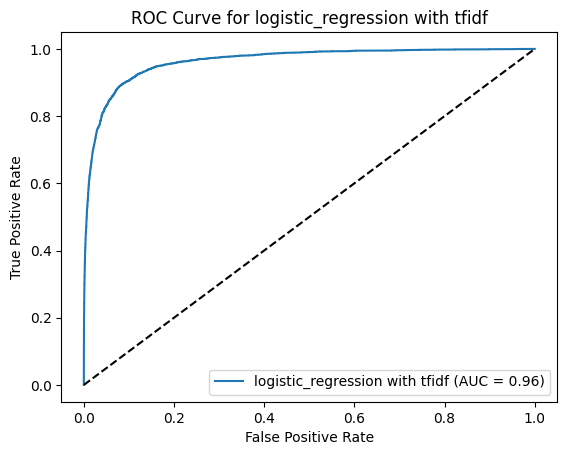

**ROC AUC score for naive_bayes with tfidf: 0.95**

Classification report for naive_bayes with tfidf:
              precision    recall  f1-score   support

           0       0.95      0.99      0.97     30160
           1       0.88      0.47      0.62      3292

    accuracy                           0.94     33452
   macro avg       0.91      0.73      0.79     33452
weighted avg       0.94      0.94      0.93     33452

Confusion matrix for naive_bayes with tfidf:
[[29952   208]
 [ 1731  1561]]


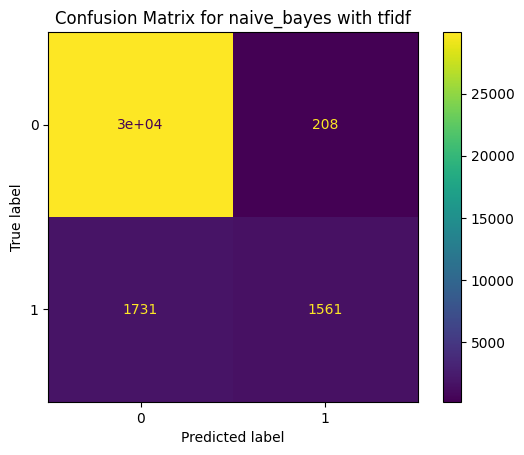

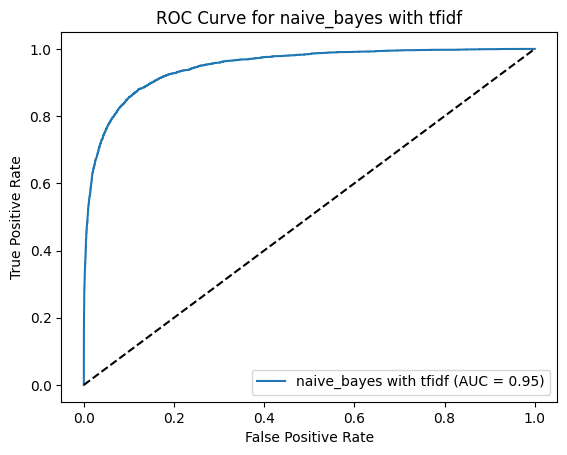

**Evaluating label: severe_toxic**

**ROC AUC score for logistic_regression with bow: 0.92**

Classification report for logistic_regression with bow:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     33159
           1       0.41      0.18      0.25       293

    accuracy                           0.99     33452
   macro avg       0.70      0.59      0.62     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix for logistic_regression with bow:
[[33083    76]
 [  241    52]]


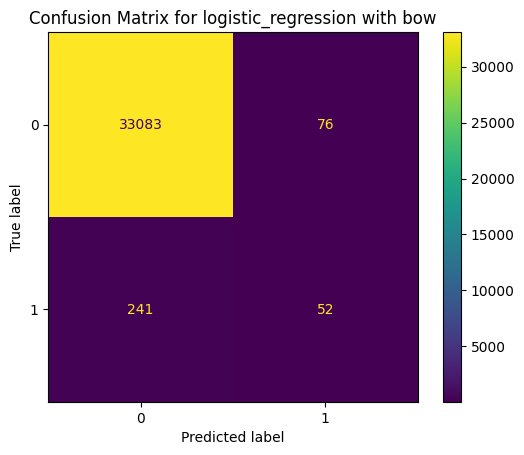

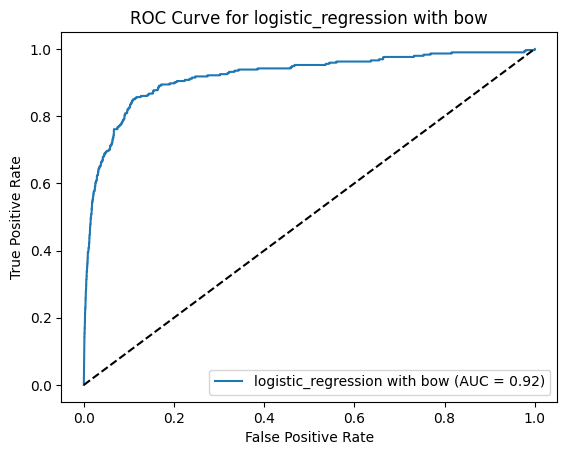

**ROC AUC score for naive_bayes with bow: 0.94**

Classification report for naive_bayes with bow:
              precision    recall  f1-score   support

           0       1.00      0.98      0.99     33159
           1       0.27      0.66      0.39       293

    accuracy                           0.98     33452
   macro avg       0.64      0.82      0.69     33452
weighted avg       0.99      0.98      0.99     33452

Confusion matrix for naive_bayes with bow:
[[32646   513]
 [   99   194]]


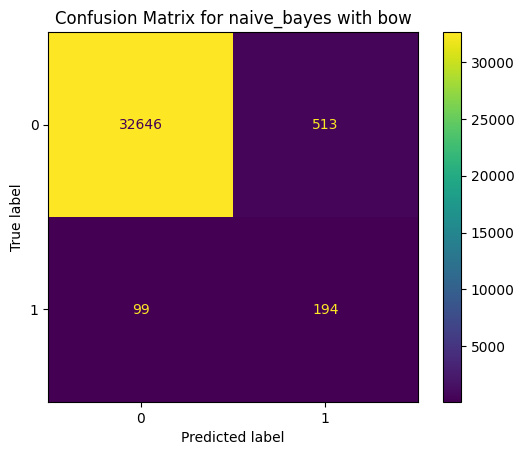

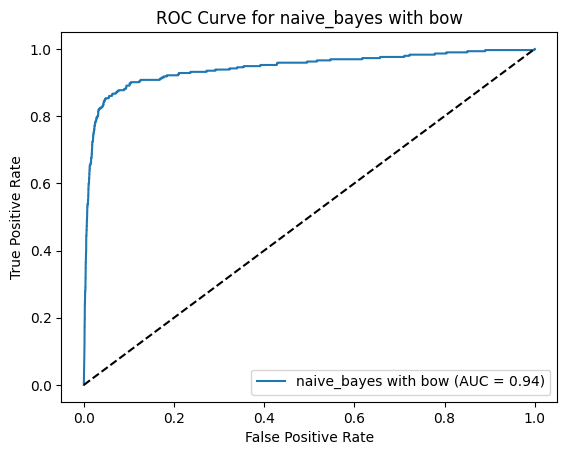

**ROC AUC score for logistic_regression with tfidf: 0.98**

Classification report for logistic_regression with tfidf:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     33159
           1       0.45      0.18      0.25       293

    accuracy                           0.99     33452
   macro avg       0.72      0.59      0.62     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix for logistic_regression with tfidf:
[[33095    64]
 [  241    52]]


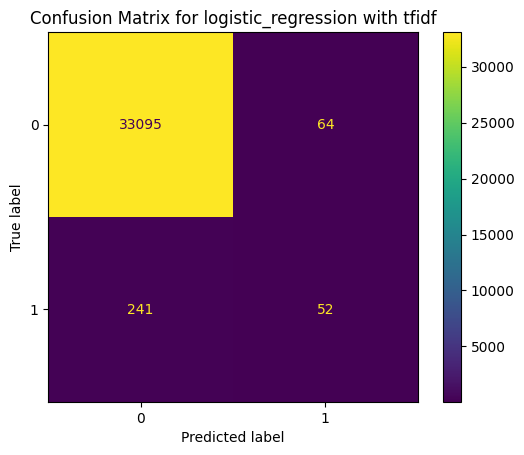

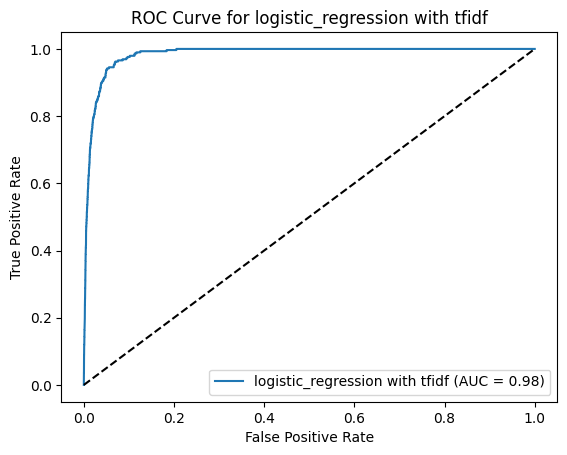

**ROC AUC score for naive_bayes with tfidf: 0.96**

Classification report for naive_bayes with tfidf:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     33159
           1       0.61      0.06      0.11       293

    accuracy                           0.99     33452
   macro avg       0.80      0.53      0.55     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix for naive_bayes with tfidf:
[[33148    11]
 [  276    17]]


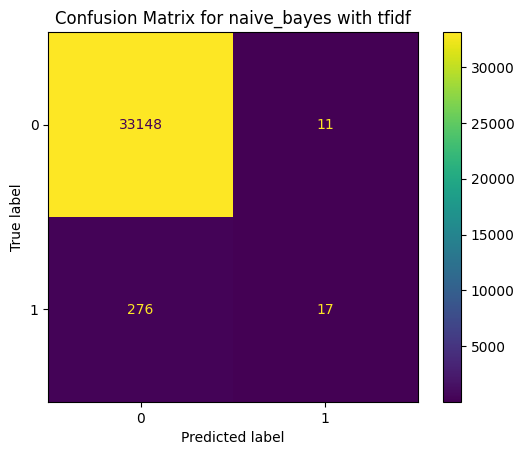

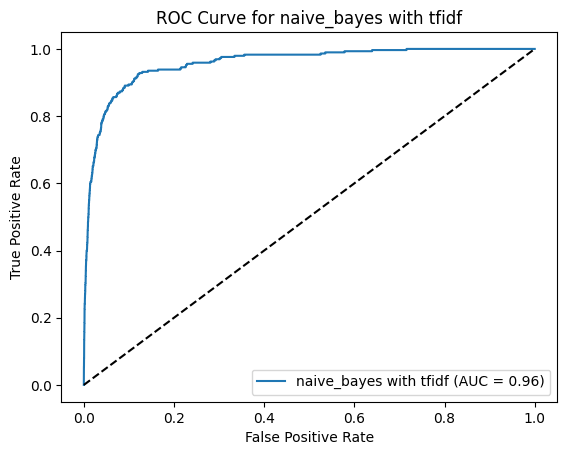

**Evaluating label: obscene**

**ROC AUC score for logistic_regression with bow: 0.95**

Classification report for logistic_regression with bow:
              precision    recall  f1-score   support

           0       0.98      0.99      0.99     31610
           1       0.81      0.64      0.72      1842

    accuracy                           0.97     33452
   macro avg       0.90      0.82      0.85     33452
weighted avg       0.97      0.97      0.97     33452

Confusion matrix for logistic_regression with bow:
[[31337   273]
 [  664  1178]]


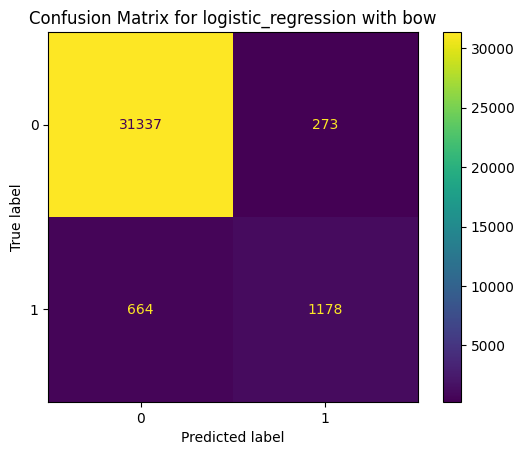

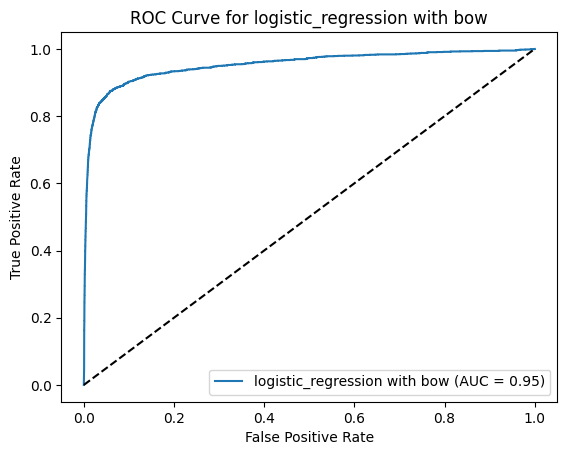

**ROC AUC score for naive_bayes with bow: 0.93**

Classification report for naive_bayes with bow:
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     31610
           1       0.66      0.73      0.69      1842

    accuracy                           0.96     33452
   macro avg       0.82      0.85      0.84     33452
weighted avg       0.97      0.96      0.97     33452

Confusion matrix for naive_bayes with bow:
[[30918   692]
 [  499  1343]]


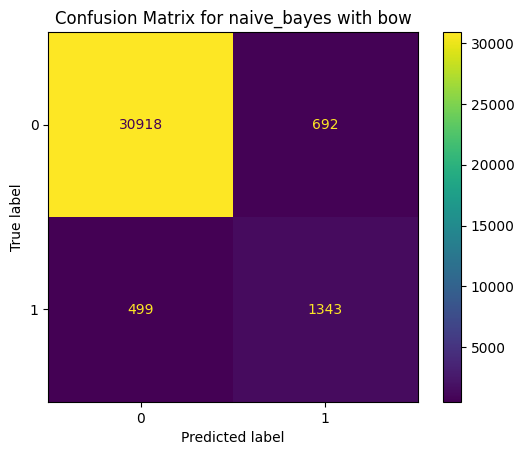

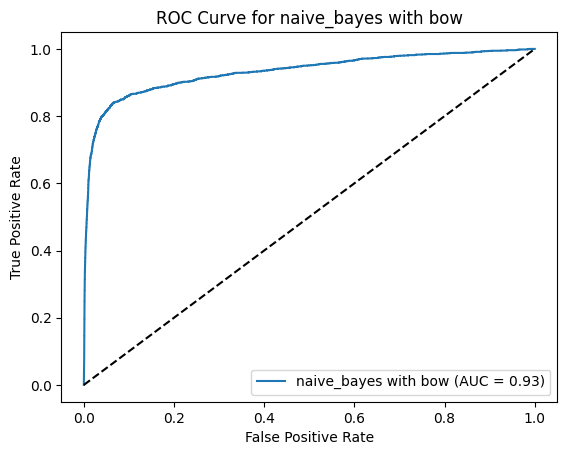

**ROC AUC score for logistic_regression with tfidf: 0.98**

Classification report for logistic_regression with tfidf:
              precision    recall  f1-score   support

           0       0.98      0.99      0.99     31610
           1       0.86      0.62      0.72      1842

    accuracy                           0.97     33452
   macro avg       0.92      0.81      0.85     33452
weighted avg       0.97      0.97      0.97     33452

Confusion matrix for logistic_regression with tfidf:
[[31425   185]
 [  693  1149]]


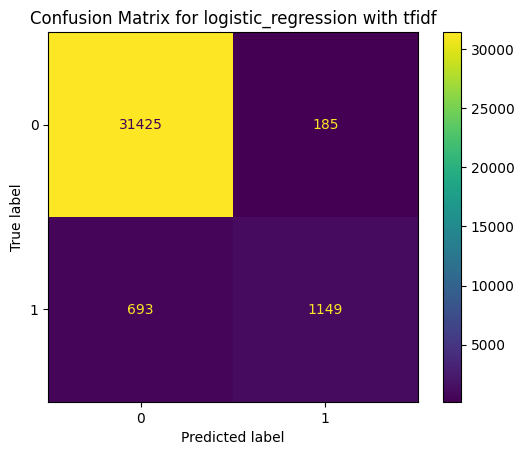

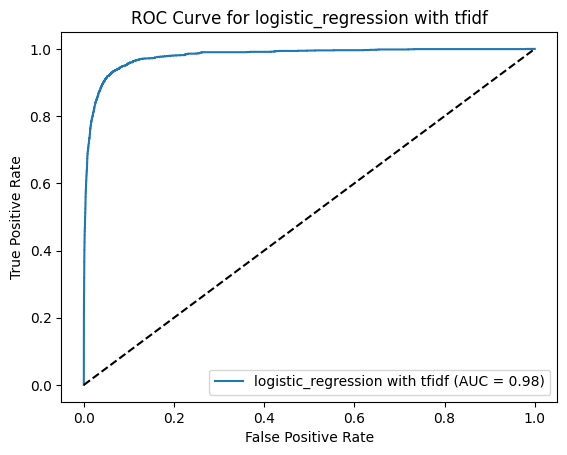

**ROC AUC score for naive_bayes with tfidf: 0.96**

Classification report for naive_bayes with tfidf:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     31610
           1       0.89      0.47      0.61      1842

    accuracy                           0.97     33452
   macro avg       0.93      0.73      0.80     33452
weighted avg       0.97      0.97      0.96     33452

Confusion matrix for naive_bayes with tfidf:
[[31503   107]
 [  979   863]]


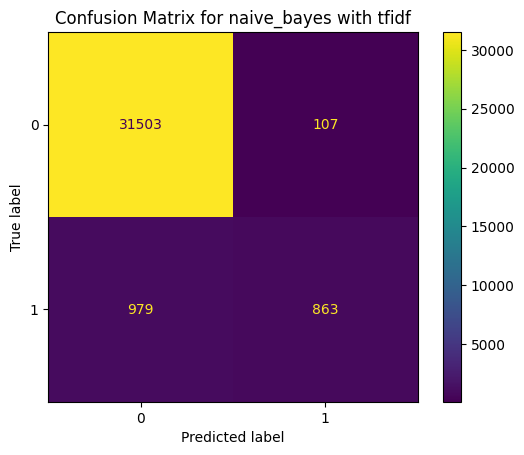

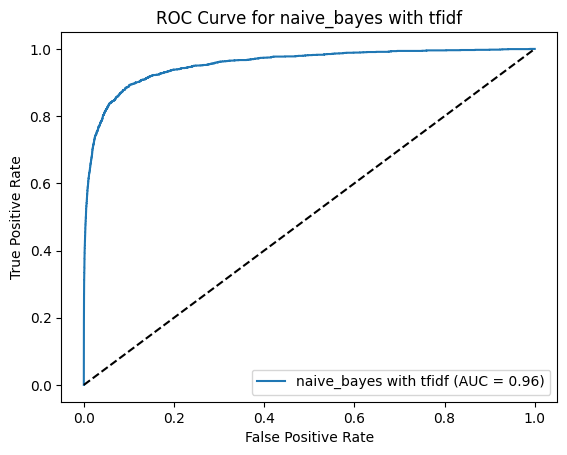

**Evaluating label: threat**

**ROC AUC score for logistic_regression with bow: 0.92**

Classification report for logistic_regression with bow:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     33352
           1       0.24      0.11      0.15       100

    accuracy                           1.00     33452
   macro avg       0.62      0.55      0.57     33452
weighted avg       1.00      1.00      1.00     33452

Confusion matrix for logistic_regression with bow:
[[33317    35]
 [   89    11]]


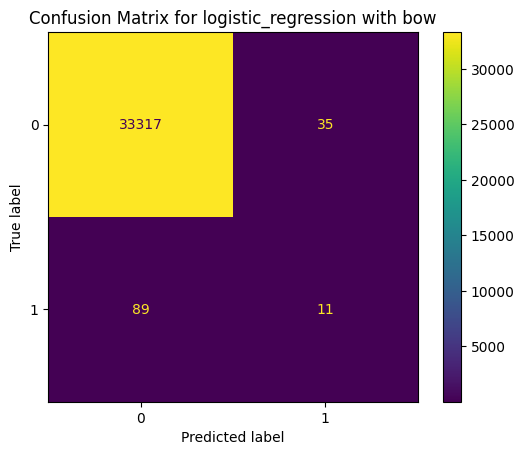

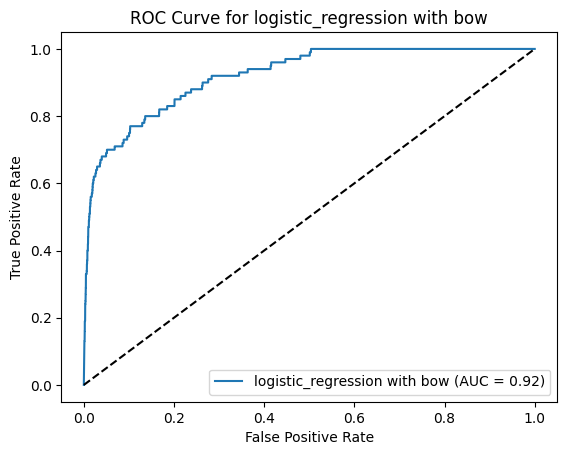

**ROC AUC score for naive_bayes with bow: 0.93**

Classification report for naive_bayes with bow:
              precision    recall  f1-score   support

           0       1.00      0.99      0.99     33352
           1       0.13      0.45      0.20       100

    accuracy                           0.99     33452
   macro avg       0.56      0.72      0.60     33452
weighted avg       1.00      0.99      0.99     33452

Confusion matrix for naive_bayes with bow:
[[33038   314]
 [   55    45]]


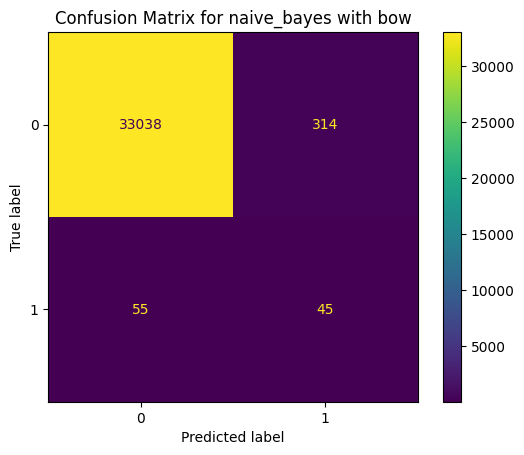

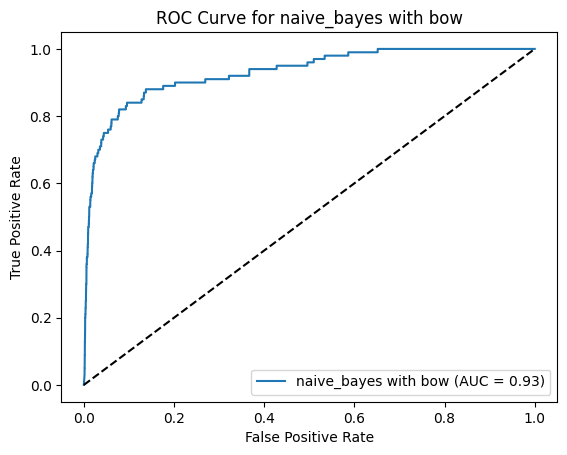

**ROC AUC score for logistic_regression with tfidf: 0.97**

Classification report for logistic_regression with tfidf:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     33352
           1       0.45      0.09      0.15       100

    accuracy                           1.00     33452
   macro avg       0.72      0.54      0.57     33452
weighted avg       1.00      1.00      1.00     33452

Confusion matrix for logistic_regression with tfidf:
[[33341    11]
 [   91     9]]


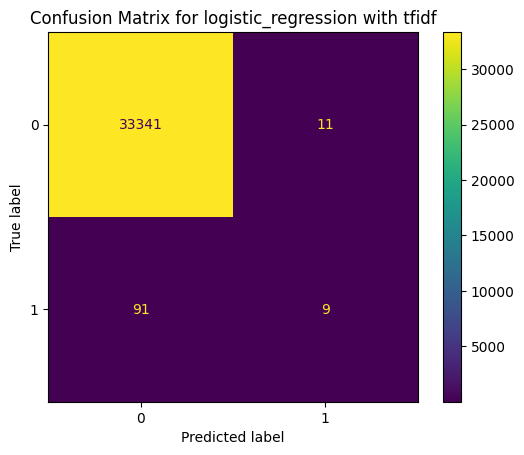

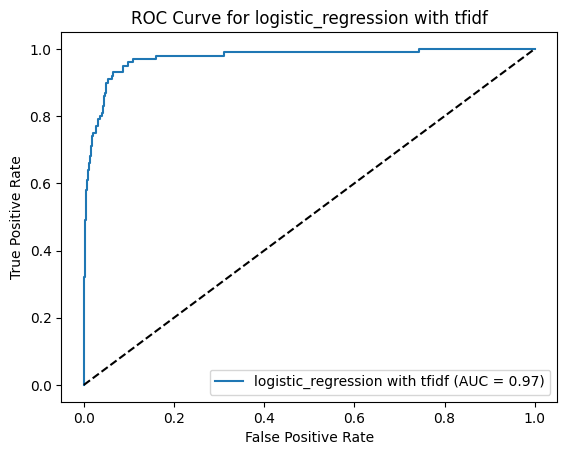

**ROC AUC score for naive_bayes with tfidf: 0.90**

Classification report for naive_bayes with tfidf:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     33352
           1       0.00      0.00      0.00       100

    accuracy                           1.00     33452
   macro avg       0.50      0.50      0.50     33452
weighted avg       0.99      1.00      1.00     33452

Confusion matrix for naive_bayes with tfidf:
[[33351     1]
 [  100     0]]


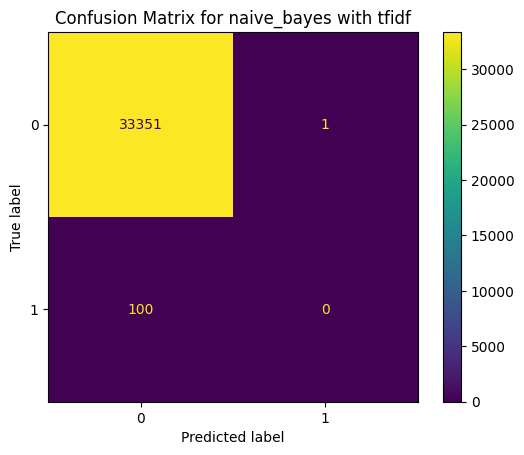

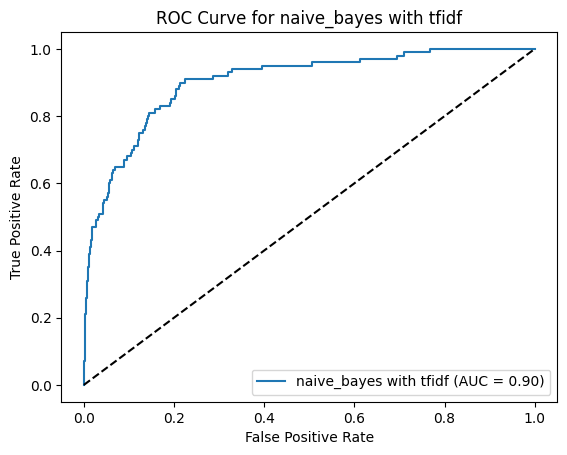

**Evaluating label: insult**

**ROC AUC score for logistic_regression with bow: 0.93**

Classification report for logistic_regression with bow:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     31702
           1       0.72      0.47      0.57      1750

    accuracy                           0.96     33452
   macro avg       0.85      0.73      0.78     33452
weighted avg       0.96      0.96      0.96     33452

Confusion matrix for logistic_regression with bow:
[[31386   316]
 [  925   825]]


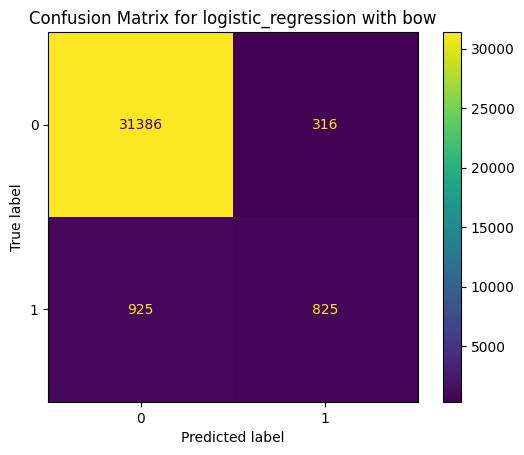

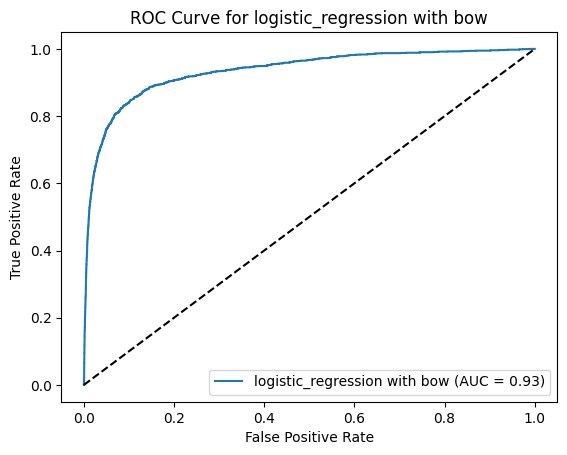

**ROC AUC score for naive_bayes with bow: 0.93**

Classification report for naive_bayes with bow:
              precision    recall  f1-score   support

           0       0.98      0.97      0.98     31702
           1       0.59      0.68      0.63      1750

    accuracy                           0.96     33452
   macro avg       0.79      0.83      0.80     33452
weighted avg       0.96      0.96      0.96     33452

Confusion matrix for naive_bayes with bow:
[[30881   821]
 [  565  1185]]


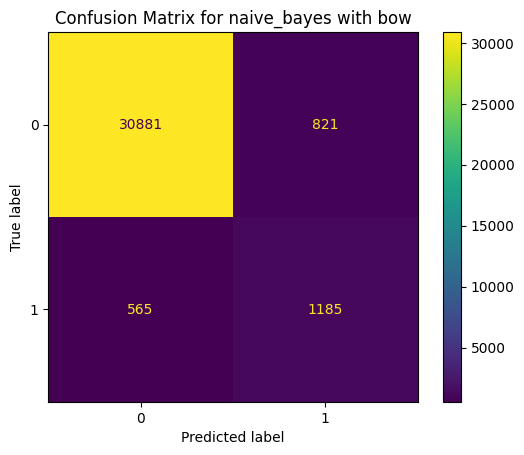

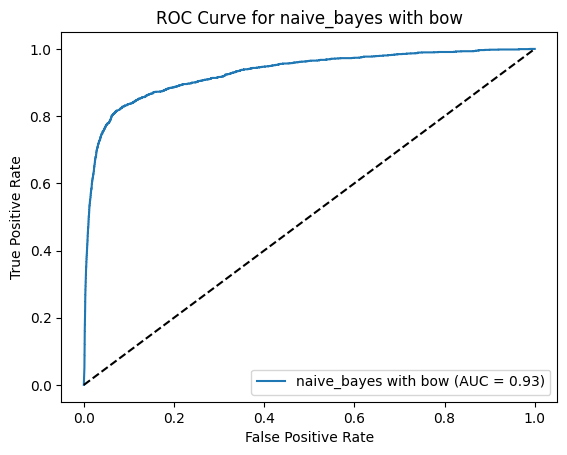

**ROC AUC score for logistic_regression with tfidf: 0.97**

Classification report for logistic_regression with tfidf:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     31702
           1       0.81      0.52      0.63      1750

    accuracy                           0.97     33452
   macro avg       0.89      0.75      0.81     33452
weighted avg       0.97      0.97      0.96     33452

Confusion matrix for logistic_regression with tfidf:
[[31491   211]
 [  848   902]]


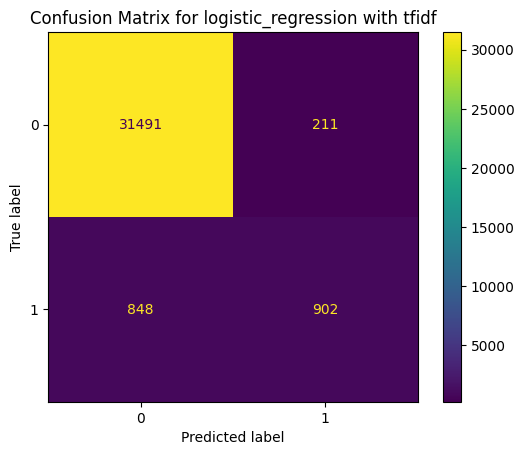

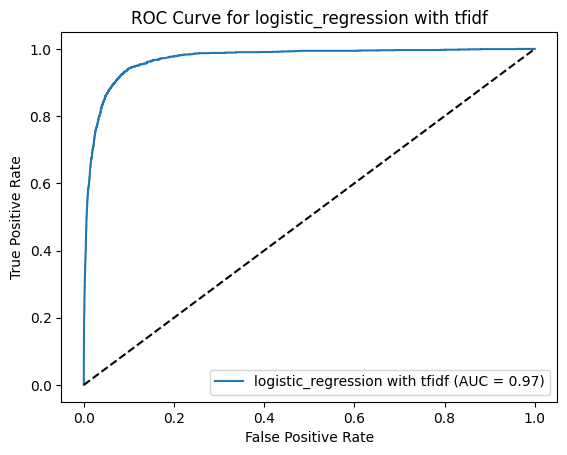

**ROC AUC score for naive_bayes with tfidf: 0.95**

Classification report for naive_bayes with tfidf:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     31702
           1       0.83      0.39      0.53      1750

    accuracy                           0.96     33452
   macro avg       0.90      0.69      0.76     33452
weighted avg       0.96      0.96      0.96     33452

Confusion matrix for naive_bayes with tfidf:
[[31562   140]
 [ 1068   682]]


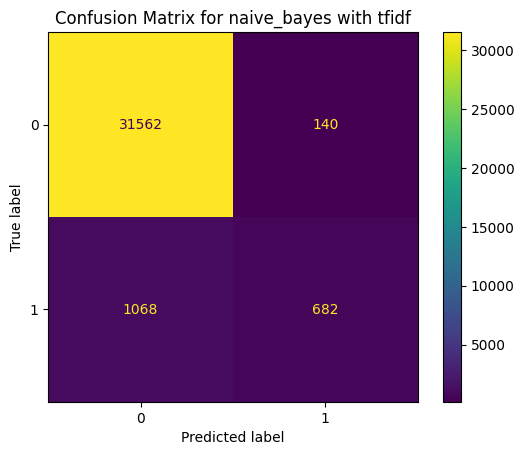

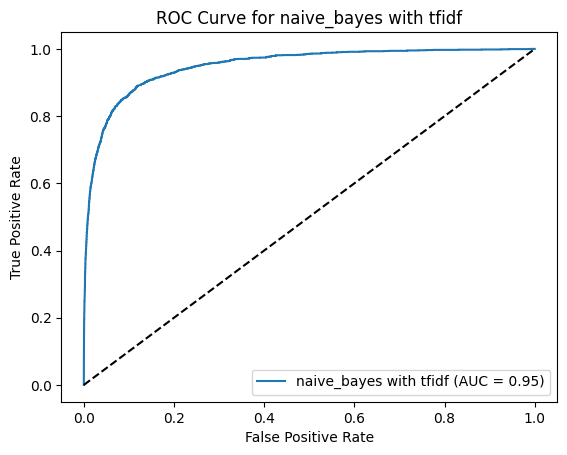

**Evaluating label: identity_hate**

**ROC AUC score for logistic_regression with bow: 0.91**

Classification report for logistic_regression with bow:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     33130
           1       0.34      0.12      0.18       322

    accuracy                           0.99     33452
   macro avg       0.67      0.56      0.59     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix for logistic_regression with bow:
[[33052    78]
 [  282    40]]


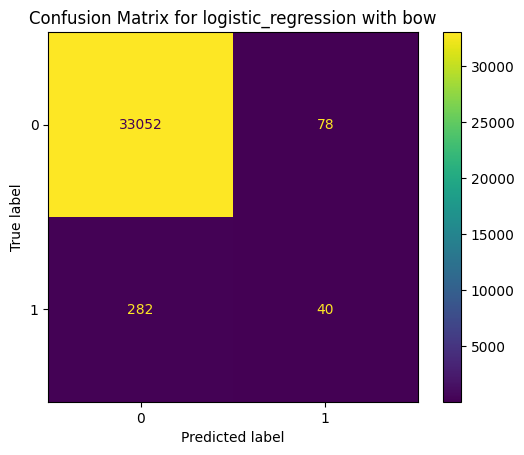

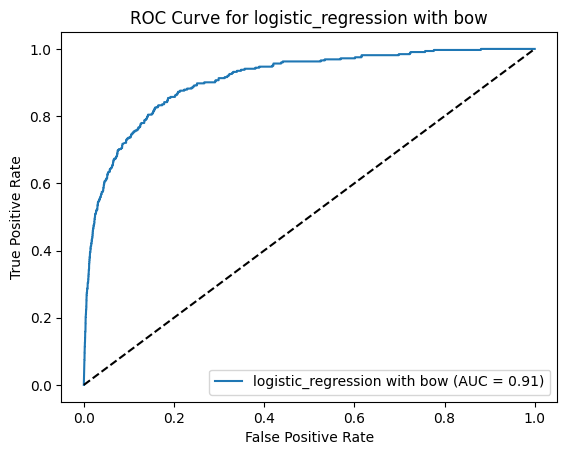

**ROC AUC score for naive_bayes with bow: 0.93**

Classification report for naive_bayes with bow:
              precision    recall  f1-score   support

           0       1.00      0.98      0.99     33130
           1       0.24      0.56      0.34       322

    accuracy                           0.98     33452
   macro avg       0.62      0.77      0.67     33452
weighted avg       0.99      0.98      0.98     33452

Confusion matrix for naive_bayes with bow:
[[32575   555]
 [  142   180]]


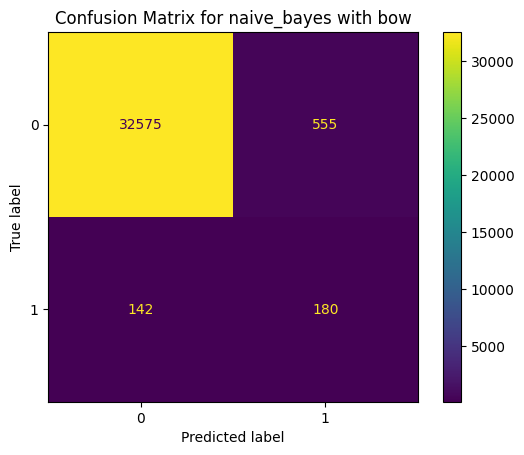

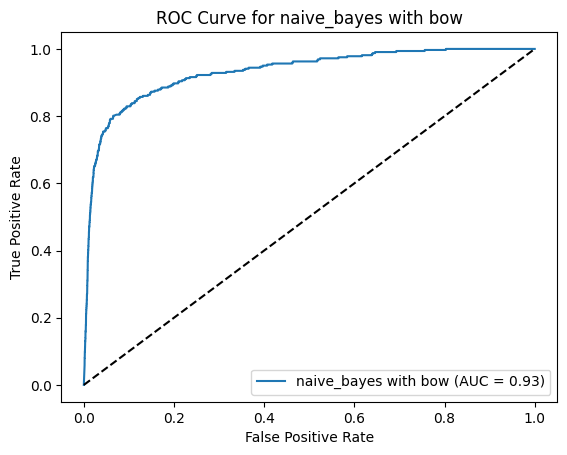

**ROC AUC score for logistic_regression with tfidf: 0.98**

Classification report for logistic_regression with tfidf:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     33130
           1       0.62      0.21      0.32       322

    accuracy                           0.99     33452
   macro avg       0.81      0.60      0.66     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix for logistic_regression with tfidf:
[[33089    41]
 [  254    68]]


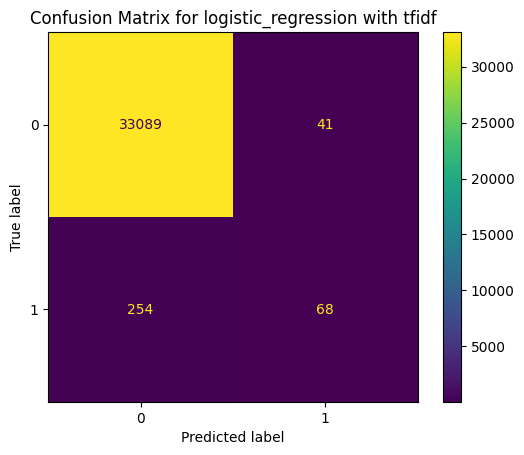

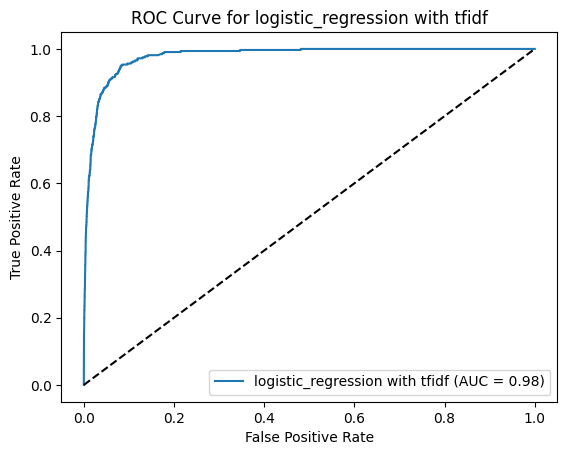

**ROC AUC score for naive_bayes with tfidf: 0.94**

Classification report for naive_bayes with tfidf:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     33130
           1       0.79      0.03      0.07       322

    accuracy                           0.99     33452
   macro avg       0.89      0.52      0.53     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix for naive_bayes with tfidf:
[[33127     3]
 [  311    11]]


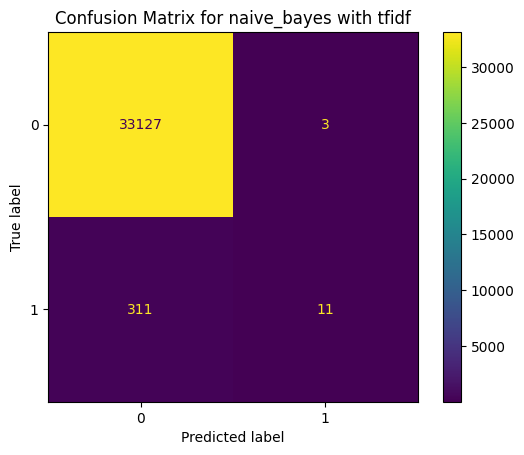

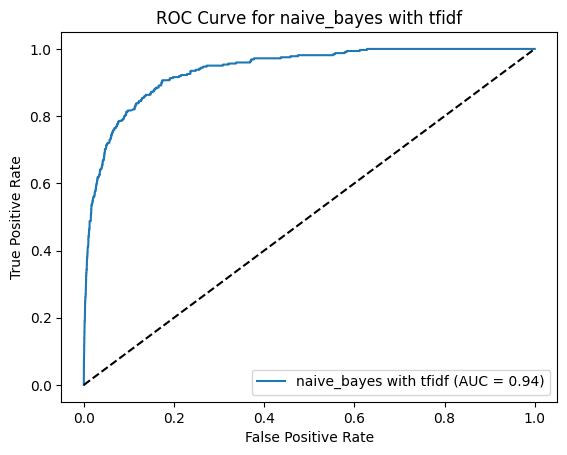

In [75]:
# Call the function to evaluate models with TF-IDF and BoW vectorizers
for label in y_variables:
    print_bold(f"Evaluating label: {label}")
    evaluate_models_with_tfidf_bow(X_train, X_val, y_train[label], y_val[label], vectorizers, algorithms)

In [76]:
# Function to tokenize and preprocess text
def tokenize_text(text):
    return word_tokenize(text.lower())  # Tokenize and lower case

In [77]:
# Function to train Word2Vec model and transform sentences into vectors
def word2vec_vectorize(sentences):
    # Train a Word2Vec model
    w2v_model = Word2Vec(sentences=sentences, vector_size=100, window=5, min_count=1, workers=4)
    
    # Average Word2Vec vectors for each document
    def document_vector(doc):
        vectors = [w2v_model.wv[word] for word in doc if word in w2v_model.wv]
        return np.mean(vectors, axis=0) if len(vectors) > 0 else np.zeros(100)
    
    return np.array([document_vector(doc) for doc in sentences])

In [78]:
# Tokenize the text
X_tokenized = data['lemmatized_comment_text'].apply(tokenize_text)

In [79]:
# Vectorize the text using the Word2Vec model
X_vectorized = word2vec_vectorize(X_tokenized)

In [80]:
# Split the dataset into train+validation and test sets (80% train+validation, 20% test)
X_train_val, X_test, y_train_val, y_test = train_test_split(X_vectorized, data[y_variables], test_size=0.2, random_state=42)

# Further split the train+validation set into train and validation sets (81.25% train, 18.75% validation of the train+validation set)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.1875, random_state=42)

# Define the number of splits for StratifiedKFold
n_splits = 5

**Evaluating label: toxic with vectorizer Word2Vec and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.95      0.99      0.97     30160
           1       0.79      0.50      0.61      3292

    accuracy                           0.94     33452
   macro avg       0.87      0.74      0.79     33452
weighted avg       0.93      0.94      0.93     33452

Confusion matrix:
[[29725   435]
 [ 1652  1640]]


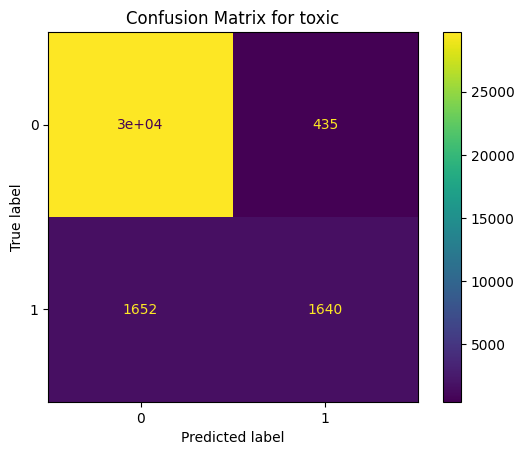

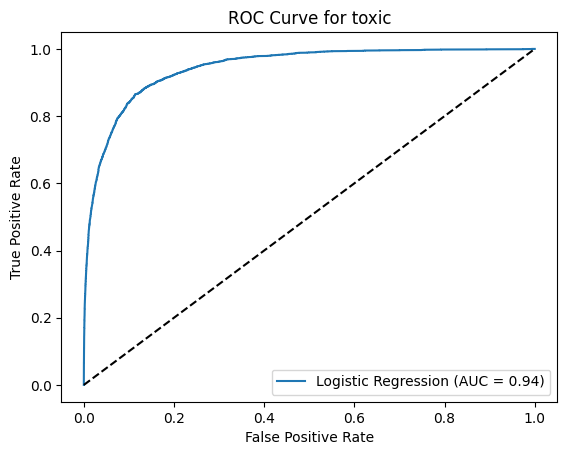

**ROC AUC score for toxic using Word2Vec as a vectorizer and Logistic Regression: 0.94**

**Evaluating label: severe_toxic with vectorizer Word2Vec and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     33159
           1       0.36      0.12      0.18       293

    accuracy                           0.99     33452
   macro avg       0.68      0.56      0.59     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix:
[[33098    61]
 [  258    35]]


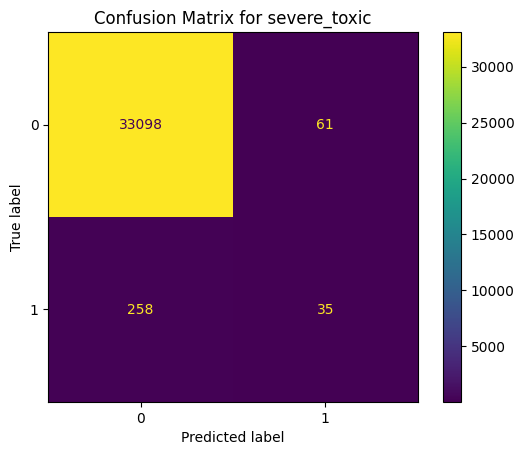

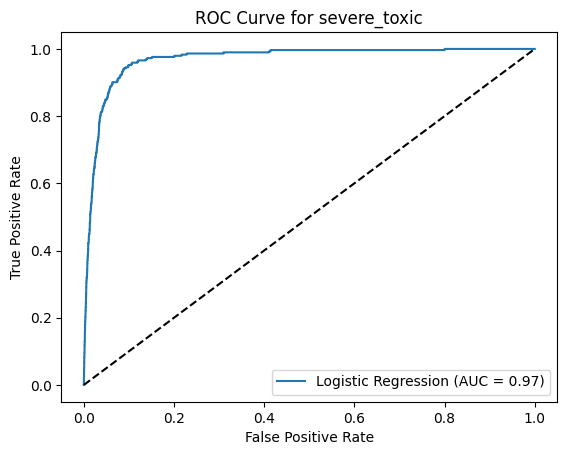

**ROC AUC score for severe_toxic using Word2Vec as a vectorizer and Logistic Regression: 0.97**

**Evaluating label: obscene with vectorizer Word2Vec and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     31610
           1       0.78      0.50      0.61      1842

    accuracy                           0.96     33452
   macro avg       0.88      0.74      0.79     33452
weighted avg       0.96      0.96      0.96     33452

Confusion matrix:
[[31352   258]
 [  926   916]]


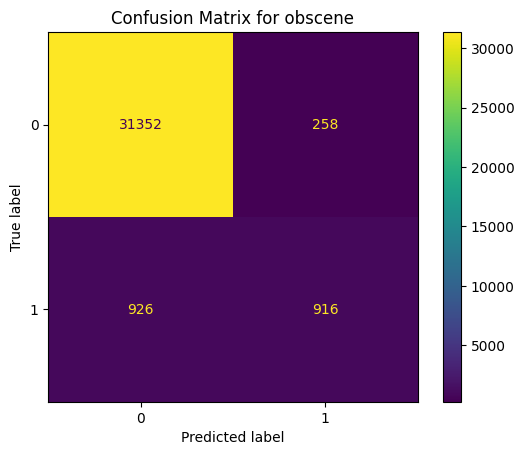

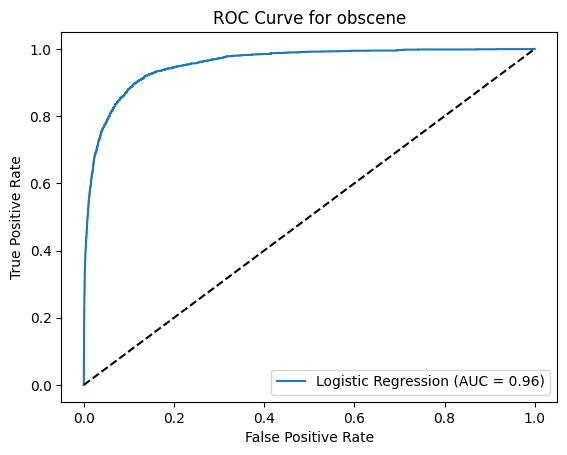

**ROC AUC score for obscene using Word2Vec as a vectorizer and Logistic Regression: 0.96**

**Evaluating label: threat with vectorizer Word2Vec and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     33352
           1       0.38      0.09      0.15       100

    accuracy                           1.00     33452
   macro avg       0.69      0.54      0.57     33452
weighted avg       1.00      1.00      1.00     33452

Confusion matrix:
[[33337    15]
 [   91     9]]


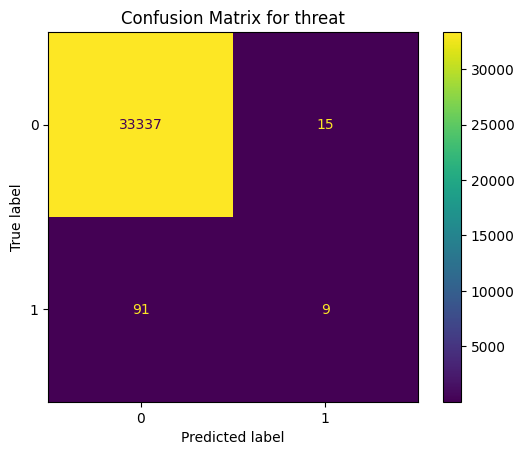

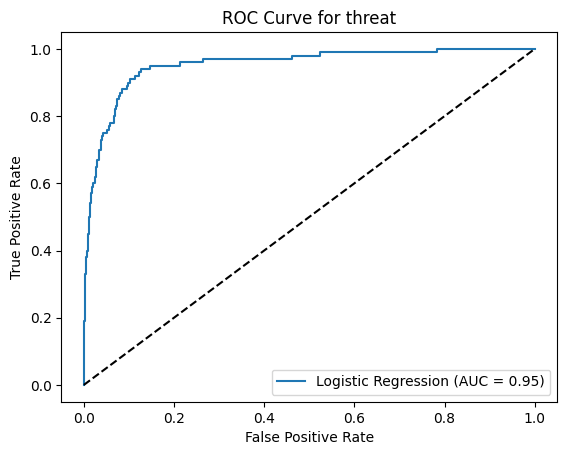

**ROC AUC score for threat using Word2Vec as a vectorizer and Logistic Regression: 0.95**

**Evaluating label: insult with vectorizer Word2Vec and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     31702
           1       0.71      0.38      0.49      1750

    accuracy                           0.96     33452
   macro avg       0.84      0.69      0.74     33452
weighted avg       0.95      0.96      0.95     33452

Confusion matrix:
[[31427   275]
 [ 1086   664]]


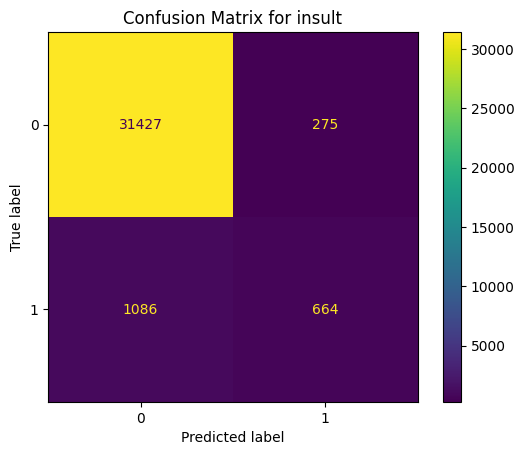

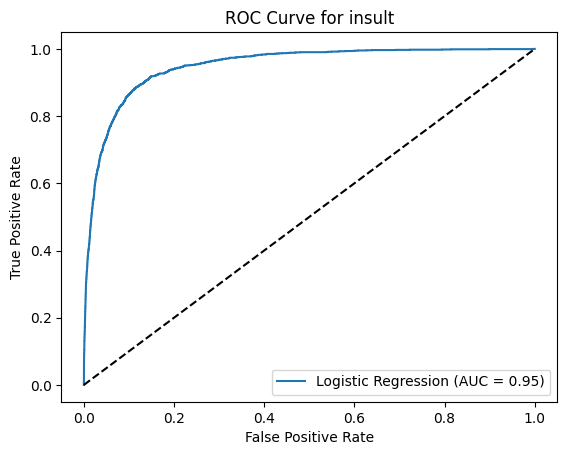

**ROC AUC score for insult using Word2Vec as a vectorizer and Logistic Regression: 0.95**

**Evaluating label: identity_hate with vectorizer Word2Vec and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     33130
           1       0.38      0.06      0.11       322

    accuracy                           0.99     33452
   macro avg       0.69      0.53      0.55     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix:
[[33098    32]
 [  302    20]]


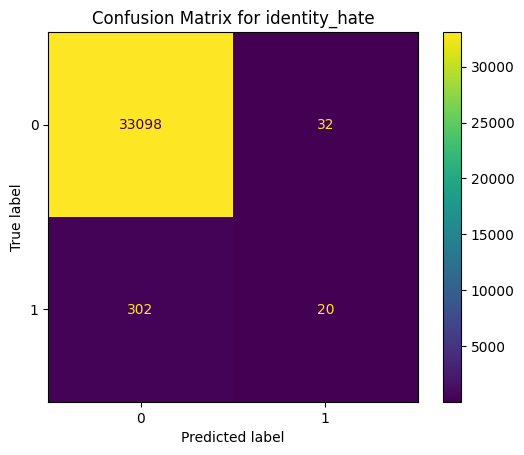

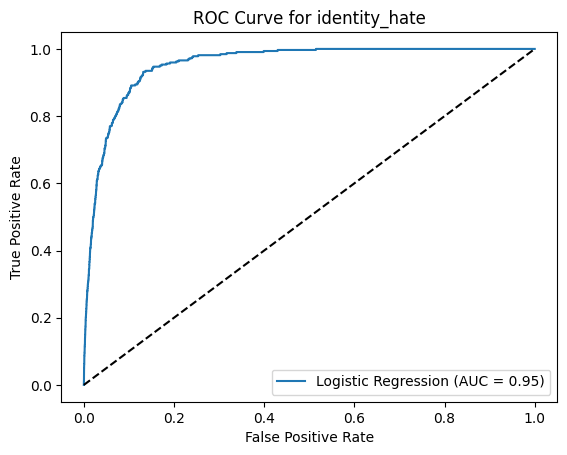

**ROC AUC score for identity_hate using Word2Vec as a vectorizer and Logistic Regression: 0.95**

In [81]:
# Evaluate the Logistic Regression model with Word2Vec vectorizer for each label
for label in y_variables:
    y_train_label = y_train[label]
    y_val_label = y_val[label]
    
    # Print the evaluation header in bold
    print_bold(f"Evaluating label: {label} with vectorizer Word2Vec and algorithm Logistic Regression")
    
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    lr = LogisticRegression(max_iter=1000, random_state=42)
    
    # Perform stratified K-fold cross-validation
    auc_scores = []
    for train_index, val_index in skf.split(X_train, y_train_label):
        X_fold_train, X_fold_val = X_train[train_index], X_train[val_index]
        y_fold_train, y_fold_val = y_train_label.iloc[train_index], y_train_label.iloc[val_index]
        
        lr.fit(X_fold_train, y_fold_train)
        y_fold_pred_prob = lr.predict_proba(X_fold_val)[:, 1]
        auc_scores.append(roc_auc_score(y_fold_val, y_fold_pred_prob))
    
    # Average AUC score across folds
    avg_auc_score = np.mean(auc_scores)
    
    # Fit the model on the full train data and evaluate on the validation set
    lr.fit(X_train, y_train_label)
    y_val_pred = lr.predict(X_val)
    y_val_pred_prob = lr.predict_proba(X_val)[:, 1]
    val_auc_score = roc_auc_score(y_val_label, y_val_pred_prob)
    
    # Print classification report
    print("Classification report:")
    print(classification_report(y_val_label, y_val_pred))
    
    # Print confusion matrix
    print("Confusion matrix:")
    conf_matrix = confusion_matrix(y_val_label, y_val_pred)
    print(conf_matrix)
    
    # Plot confusion matrix diagram
    ConfusionMatrixDisplay.from_predictions(y_val_label, y_val_pred)
    plt.title(f'Confusion Matrix for {label}')
    plt.show()
    
    # Plot ROC curve
    fpr, tpr, _ = roc_curve(y_val_label, y_val_pred_prob)
    plt.plot(fpr, tpr, label=f'Logistic Regression (AUC = {val_auc_score:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve for {label}')
    plt.legend(loc='lower right')
    plt.show()
    
    # Print ROC AUC score in bold
    print_bold(f"ROC AUC score for {label} using Word2Vec as a vectorizer and Logistic Regression: {val_auc_score:.2f}")

**Evaluating label: toxic with vectorizer Word2Vec and algorithm Gaussian Naive Bayes**

Classification report:
              precision    recall  f1-score   support

           0       0.97      0.91      0.94     30160
           1       0.47      0.72      0.57      3292

    accuracy                           0.89     33452
   macro avg       0.72      0.82      0.76     33452
weighted avg       0.92      0.89      0.90     33452

Confusion matrix:
[[27537  2623]
 [  929  2363]]


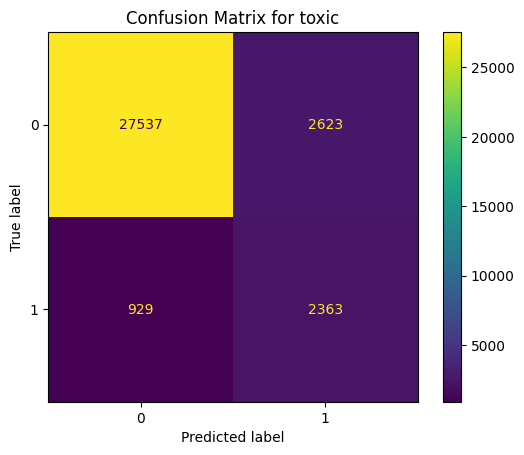

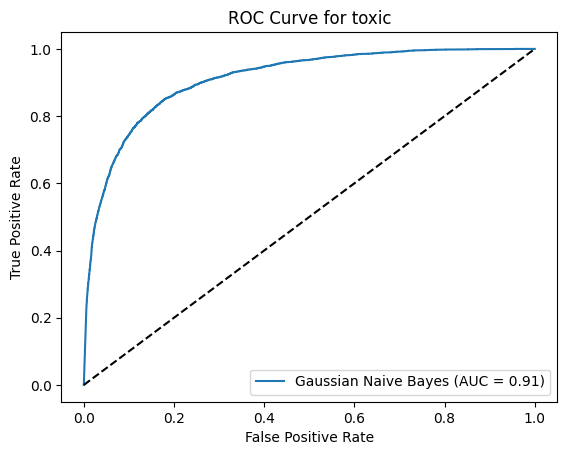

**ROC AUC score for toxic using Word2Vec as a vectorizer and Gaussian Naive Bayes: 0.91**

**Evaluating label: severe_toxic with vectorizer Word2Vec and algorithm Gaussian Naive Bayes**

Classification report:
              precision    recall  f1-score   support

           0       1.00      0.95      0.97     33159
           1       0.12      0.84      0.21       293

    accuracy                           0.95     33452
   macro avg       0.56      0.89      0.59     33452
weighted avg       0.99      0.95      0.97     33452

Confusion matrix:
[[31399  1760]
 [   47   246]]


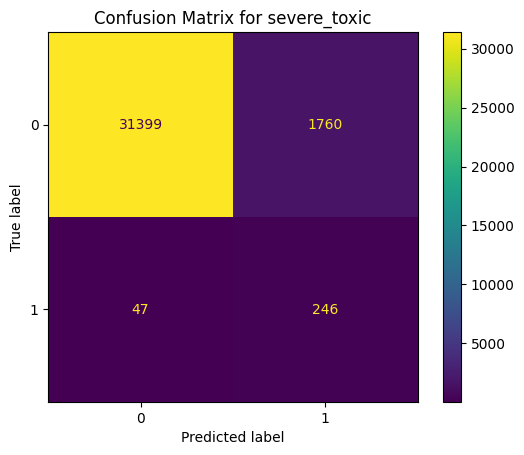

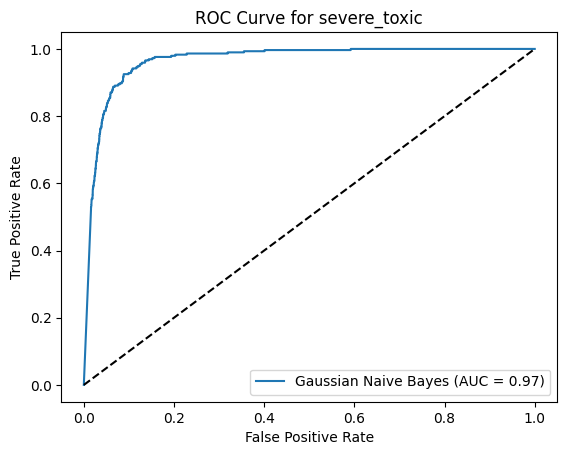

**ROC AUC score for severe_toxic using Word2Vec as a vectorizer and Gaussian Naive Bayes: 0.97**

**Evaluating label: obscene with vectorizer Word2Vec and algorithm Gaussian Naive Bayes**

Classification report:
              precision    recall  f1-score   support

           0       0.98      0.93      0.96     31610
           1       0.37      0.74      0.50      1842

    accuracy                           0.92     33452
   macro avg       0.68      0.83      0.73     33452
weighted avg       0.95      0.92      0.93     33452

Confusion matrix:
[[29326  2284]
 [  477  1365]]


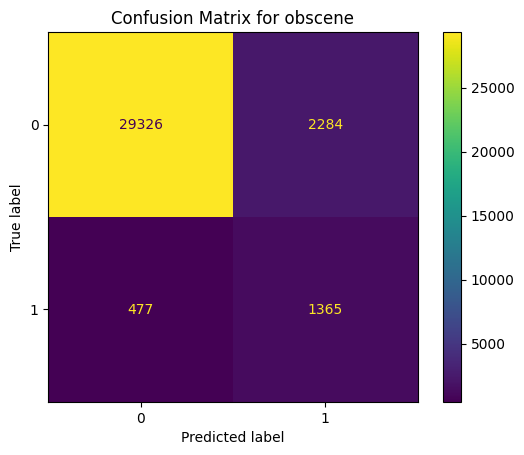

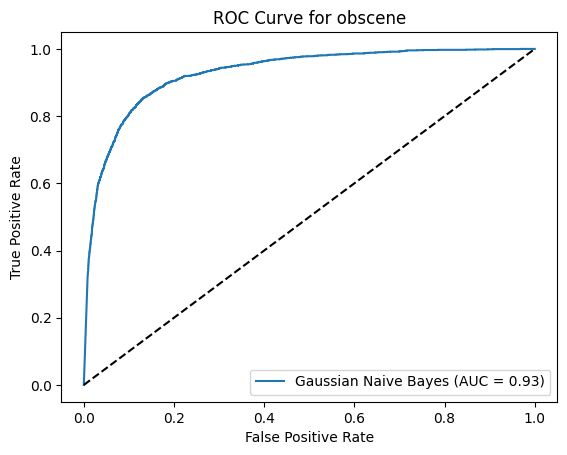

**ROC AUC score for obscene using Word2Vec as a vectorizer and Gaussian Naive Bayes: 0.93**

**Evaluating label: threat with vectorizer Word2Vec and algorithm Gaussian Naive Bayes**

Classification report:
              precision    recall  f1-score   support

           0       1.00      0.93      0.96     33352
           1       0.03      0.80      0.06       100

    accuracy                           0.93     33452
   macro avg       0.52      0.86      0.51     33452
weighted avg       1.00      0.93      0.96     33452

Confusion matrix:
[[30925  2427]
 [   20    80]]


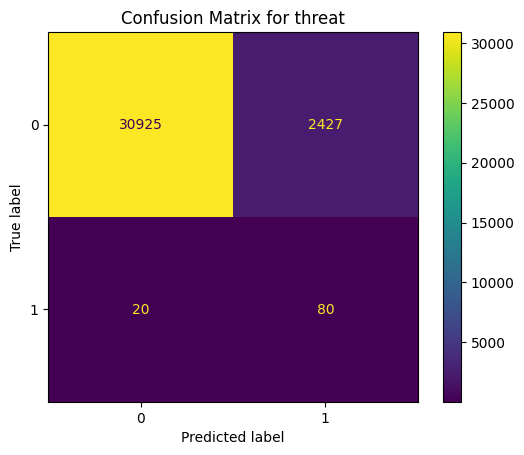

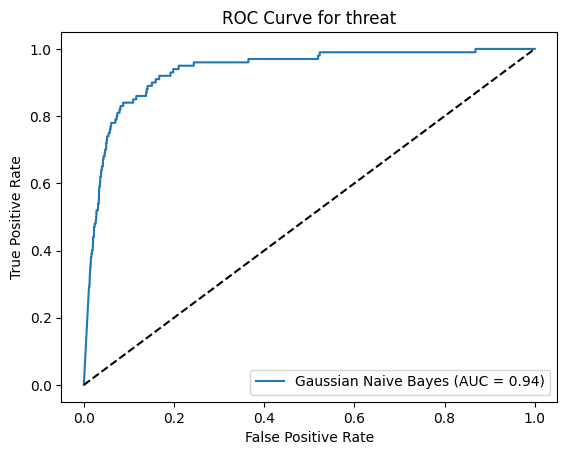

**ROC AUC score for threat using Word2Vec as a vectorizer and Gaussian Naive Bayes: 0.94**

**Evaluating label: insult with vectorizer Word2Vec and algorithm Gaussian Naive Bayes**

Classification report:
              precision    recall  f1-score   support

           0       0.99      0.92      0.95     31702
           1       0.35      0.75      0.48      1750

    accuracy                           0.91     33452
   macro avg       0.67      0.84      0.71     33452
weighted avg       0.95      0.91      0.93     33452

Confusion matrix:
[[29255  2447]
 [  442  1308]]


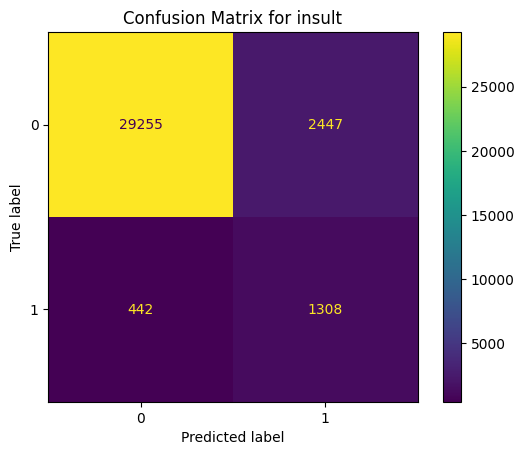

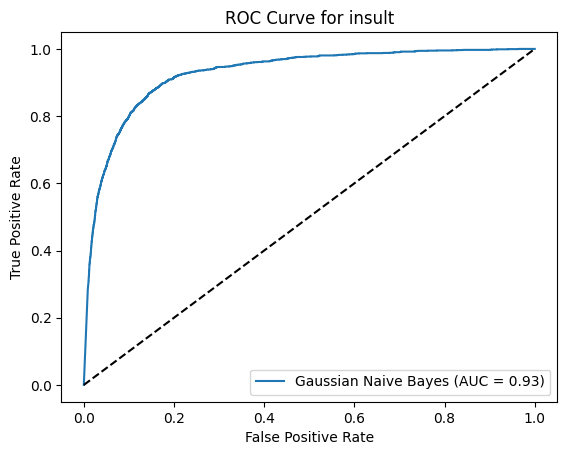

**ROC AUC score for insult using Word2Vec as a vectorizer and Gaussian Naive Bayes: 0.93**

**Evaluating label: identity_hate with vectorizer Word2Vec and algorithm Gaussian Naive Bayes**

Classification report:
              precision    recall  f1-score   support

           0       1.00      0.92      0.96     33130
           1       0.09      0.81      0.16       322

    accuracy                           0.92     33452
   macro avg       0.54      0.87      0.56     33452
weighted avg       0.99      0.92      0.95     33452

Confusion matrix:
[[30508  2622]
 [   61   261]]


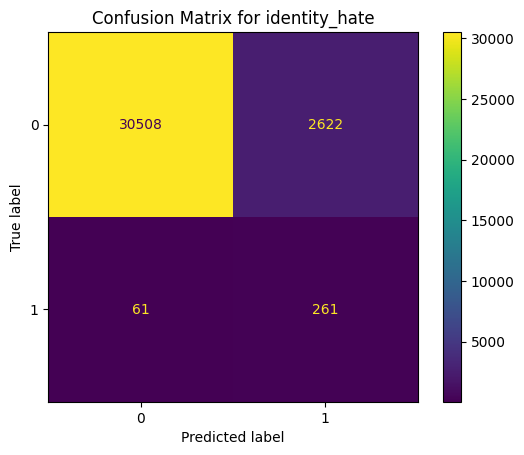

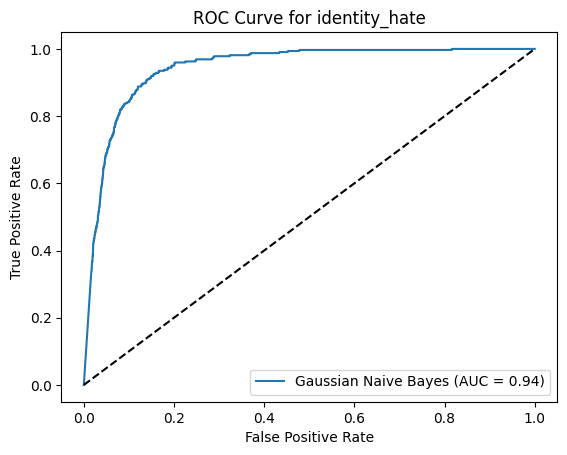

**ROC AUC score for identity_hate using Word2Vec as a vectorizer and Gaussian Naive Bayes: 0.94**

In [82]:
# Evaluate the Gaussian Naive Bayes model with Word2Vec vectorizer for each label
for label in y_variables:
    y_train_label = y_train[label]
    y_val_label = y_val[label]
    
    # Print the evaluation header in bold
    print_bold(f"Evaluating label: {label} with vectorizer Word2Vec and algorithm Gaussian Naive Bayes")
    
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    gnb = GaussianNB()
    
    # Perform stratified K-fold cross-validation
    auc_scores = []
    for train_index, val_index in skf.split(X_train, y_train_label):
        X_fold_train, X_fold_val = X_train[train_index], X_train[val_index]
        y_fold_train, y_fold_val = y_train_label.iloc[train_index], y_train_label.iloc[val_index]
        
        gnb.fit(X_fold_train, y_fold_train)
        y_fold_pred_prob = gnb.predict_proba(X_fold_val)[:, 1]
        auc_scores.append(roc_auc_score(y_fold_val, y_fold_pred_prob))
    
    # Average AUC score across folds
    avg_auc_score = np.mean(auc_scores)
    
    # Fit the model on the full train data and evaluate on the validation set
    gnb.fit(X_train, y_train_label)
    y_val_pred = gnb.predict(X_val)
    y_val_pred_prob = gnb.predict_proba(X_val)[:, 1]
    val_auc_score = roc_auc_score(y_val_label, y_val_pred_prob)
    
    # Print classification report
    print("Classification report:")
    print(classification_report(y_val_label, y_val_pred))
    
    # Print confusion matrix
    print("Confusion matrix:")
    conf_matrix = confusion_matrix(y_val_label, y_val_pred)
    print(conf_matrix)
    
    # Plot confusion matrix diagram
    ConfusionMatrixDisplay.from_predictions(y_val_label, y_val_pred)
    plt.title(f'Confusion Matrix for {label}')
    plt.show()
    
    # Plot ROC curve
    fpr, tpr, _ = roc_curve(y_val_label, y_val_pred_prob)
    plt.plot(fpr, tpr, label=f'Gaussian Naive Bayes (AUC = {val_auc_score:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve for {label}')
    plt.legend(loc='lower right')
    plt.show()
    
    # Print ROC AUC score in bold
    print_bold(f"ROC AUC score for {label} using Word2Vec as a vectorizer and Gaussian Naive Bayes: {val_auc_score:.2f}")

**Evaluating label: toxic with vectorizer TF-IDF and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.95      0.99      0.97     30160
           1       0.88      0.55      0.68      3292

    accuracy                           0.95     33452
   macro avg       0.92      0.77      0.83     33452
weighted avg       0.95      0.95      0.94     33452

Confusion matrix:
[[29911   249]
 [ 1470  1822]]


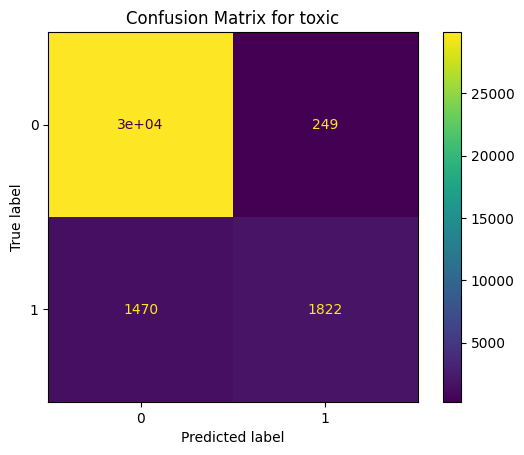

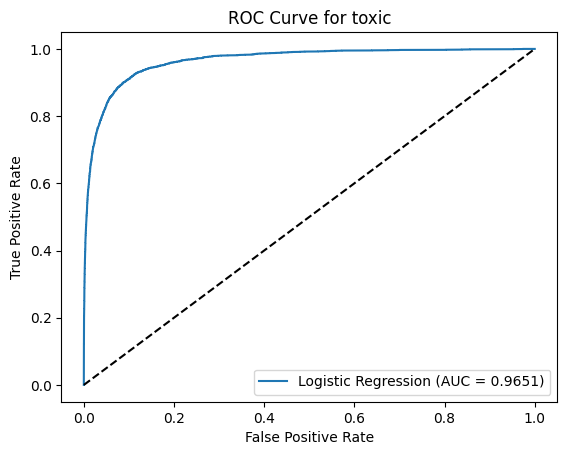

**ROC AUC score for toxic using TF-IDF as a vectorizer and Logistic Regression: 0.9651**

**Evaluating label: severe_toxic with vectorizer TF-IDF and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     33159
           1       0.50      0.18      0.27       293

    accuracy                           0.99     33452
   macro avg       0.75      0.59      0.63     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix:
[[33106    53]
 [  240    53]]


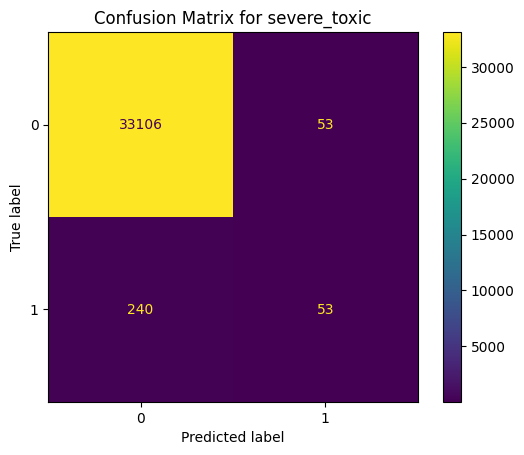

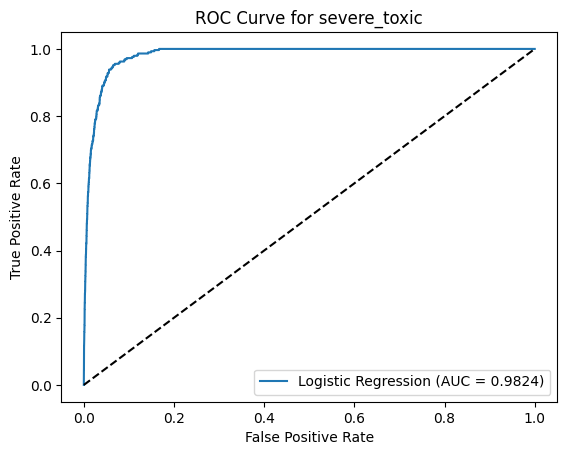

**ROC AUC score for severe_toxic using TF-IDF as a vectorizer and Logistic Regression: 0.9824**

**Evaluating label: obscene with vectorizer TF-IDF and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.98      0.99      0.99     31610
           1       0.87      0.59      0.70      1842

    accuracy                           0.97     33452
   macro avg       0.92      0.79      0.84     33452
weighted avg       0.97      0.97      0.97     33452

Confusion matrix:
[[31451   159]
 [  756  1086]]


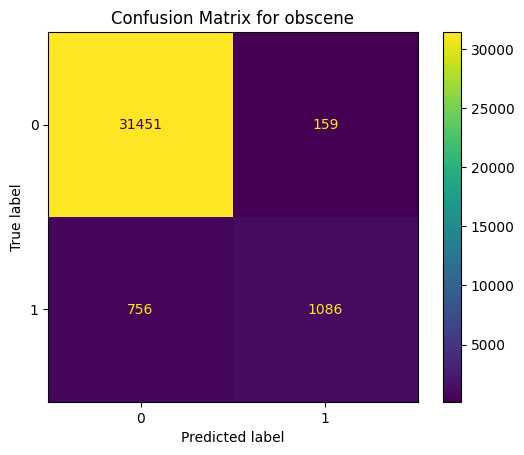

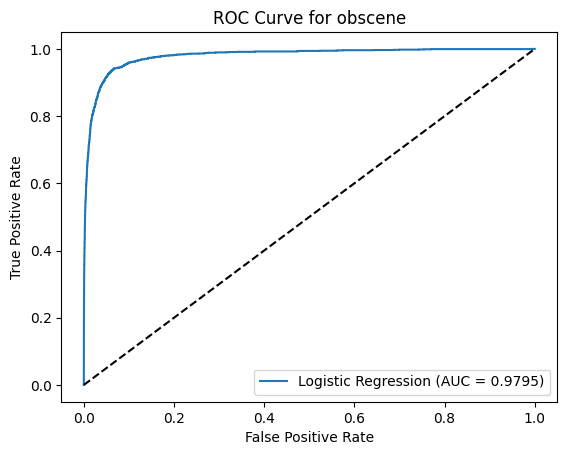

**ROC AUC score for obscene using TF-IDF as a vectorizer and Logistic Regression: 0.9795**

**Evaluating label: threat with vectorizer TF-IDF and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     33352
           1       0.53      0.08      0.14       100

    accuracy                           1.00     33452
   macro avg       0.77      0.54      0.57     33452
weighted avg       1.00      1.00      1.00     33452

Confusion matrix:
[[33345     7]
 [   92     8]]


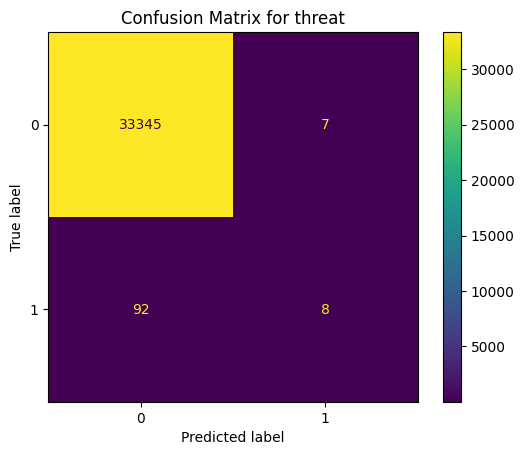

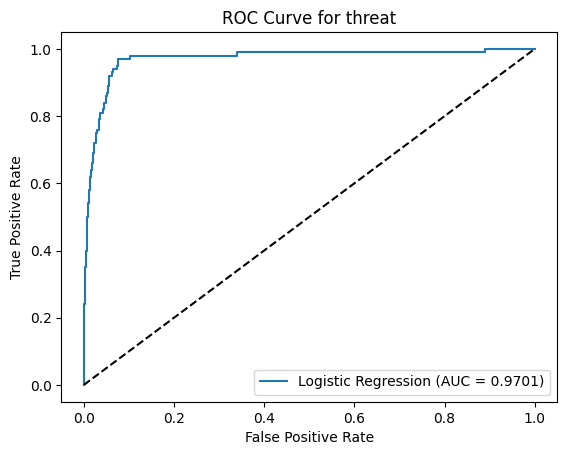

**ROC AUC score for threat using TF-IDF as a vectorizer and Logistic Regression: 0.9701**

**Evaluating label: insult with vectorizer TF-IDF and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     31702
           1       0.82      0.47      0.59      1750

    accuracy                           0.97     33452
   macro avg       0.90      0.73      0.79     33452
weighted avg       0.96      0.97      0.96     33452

Confusion matrix:
[[31523   179]
 [  935   815]]


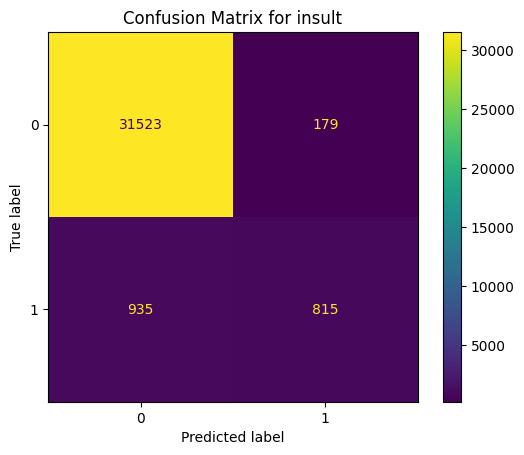

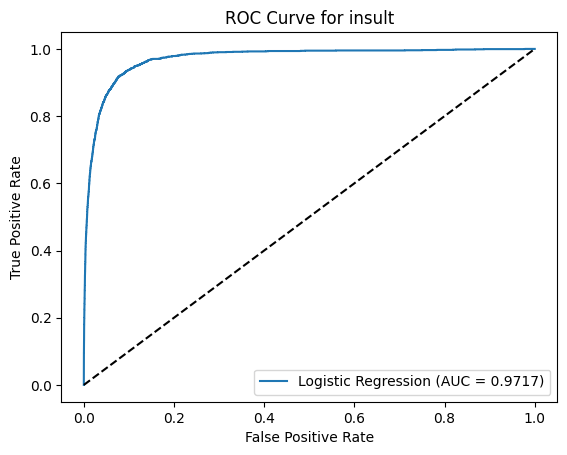

**ROC AUC score for insult using TF-IDF as a vectorizer and Logistic Regression: 0.9717**

**Evaluating label: identity_hate with vectorizer TF-IDF and algorithm Logistic Regression**

Classification report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     33130
           1       0.62      0.18      0.28       322

    accuracy                           0.99     33452
   macro avg       0.81      0.59      0.64     33452
weighted avg       0.99      0.99      0.99     33452

Confusion matrix:
[[33095    35]
 [  265    57]]


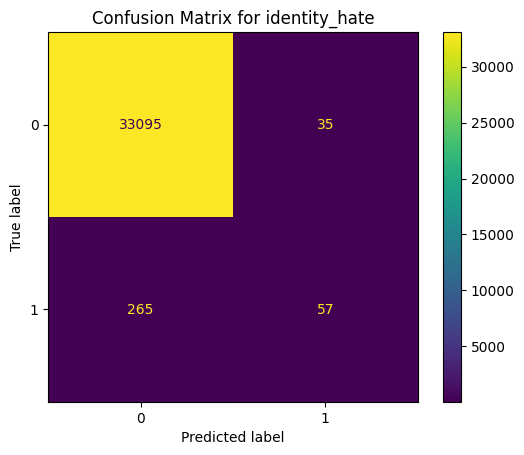

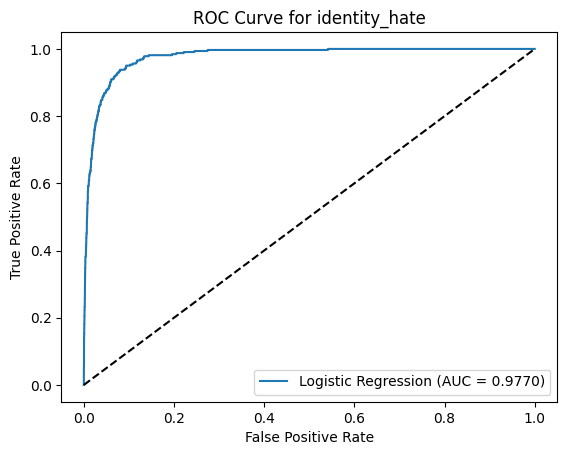

**ROC AUC score for identity_hate using TF-IDF as a vectorizer and Logistic Regression: 0.9770**

In [83]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, roc_curve, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
from IPython.display import Markdown, display

# Function to print in bold
def print_bold(text):
    display(Markdown(f"**{text}**"))

# Assuming data is your dataset with 'comment_text' and y variables
# data = pd.read_csv('data.csv')  # Uncomment this line if you're reading from a CSV file

# Initialize TF-IDF vectorizer
tfidf_vectorizer = TfidfVectorizer()

# Vectorize the text using the TF-IDF vectorizer
X_tfidf = tfidf_vectorizer.fit_transform(data['lemmatized_comment_text'])

# List of y variables
y_variables = ['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']

# Split the dataset into train and test sets (80% train, 20% test)
X_train_test, X_test, y_train_test, y_test = train_test_split(
    X_tfidf, data[y_variables], test_size=0.2, random_state=42
)

# Calculate the proportion for validation set relative to the train_test split
validation_proportion = 0.15 / 0.8
# Further split the train set into train and validation sets (65% train, 15% validation of the original data)
X_train, X_val, y_train, y_val = train_test_split(
    X_train_test, y_train_test, test_size=validation_proportion, random_state=42
)

# Define the number of splits for StratifiedKFold
n_splits = 5
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Evaluate the Logistic Regression model with TF-IDF vectorizer for each label
for label in y_variables:
    y_train_label = y_train[label]
    y_val_label = y_val[label]
    
    # Print the evaluation header in bold
    print_bold(f"Evaluating label: {label} with vectorizer TF-IDF and algorithm Logistic Regression")
    
    lr = LogisticRegression(max_iter=1000, random_state=42)
    
    # Perform stratified K-fold cross-validation
    auc_scores = []
    for train_index, val_index in skf.split(X_train, y_train_label):
        X_fold_train, X_fold_val = X_train[train_index], X_train[val_index]
        y_fold_train, y_fold_val = y_train_label.iloc[train_index], y_train_label.iloc[val_index]
        
        lr.fit(X_fold_train, y_fold_train)
        y_fold_pred_prob = lr.predict_proba(X_fold_val)[:, 1]
        auc_scores.append(roc_auc_score(y_fold_val, y_fold_pred_prob))
    
    # Average AUC score across folds
    avg_auc_score = np.mean(auc_scores)
    
    # Fit the model on the full train data and evaluate on the validation set
    lr.fit(X_train, y_train_label)
    y_val_pred = lr.predict(X_val)
    y_val_pred_prob = lr.predict_proba(X_val)[:, 1]
    val_auc_score = roc_auc_score(y_val_label, y_val_pred_prob)
    
    # Print classification report
    print("Classification report:")
    print(classification_report(y_val_label, y_val_pred))
    
    # Print confusion matrix
    print("Confusion matrix:")
    conf_matrix = confusion_matrix(y_val_label, y_val_pred)
    print(conf_matrix)
    
    # Plot confusion matrix diagram
    ConfusionMatrixDisplay.from_predictions(y_val_label, y_val_pred)
    plt.title(f'Confusion Matrix for {label}')
    plt.show()
    
    # Plot ROC curve
    fpr, tpr, _ = roc_curve(y_val_label, y_val_pred_prob)
    plt.plot(fpr, tpr, label=f'Logistic Regression (AUC = {val_auc_score:.4f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve for {label}')
    plt.legend(loc='lower right')
    plt.show()
    
    # Print ROC AUC score in bold to four decimal places
    print_bold(f"ROC AUC score for {label} using TF-IDF as a vectorizer and Logistic Regression: {val_auc_score:.4f}")